/tmp/ipykernel_23996/1351770889.py:43: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(G, pos, edgelist=edges, width=[3*abs(w) for w in weights],
/tmp/ipykernel_23996/1351770889.py:47: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(plt.cm.ScalarMappable(cmap=plt.cm.coolwarm), label="Spearman Correlation")


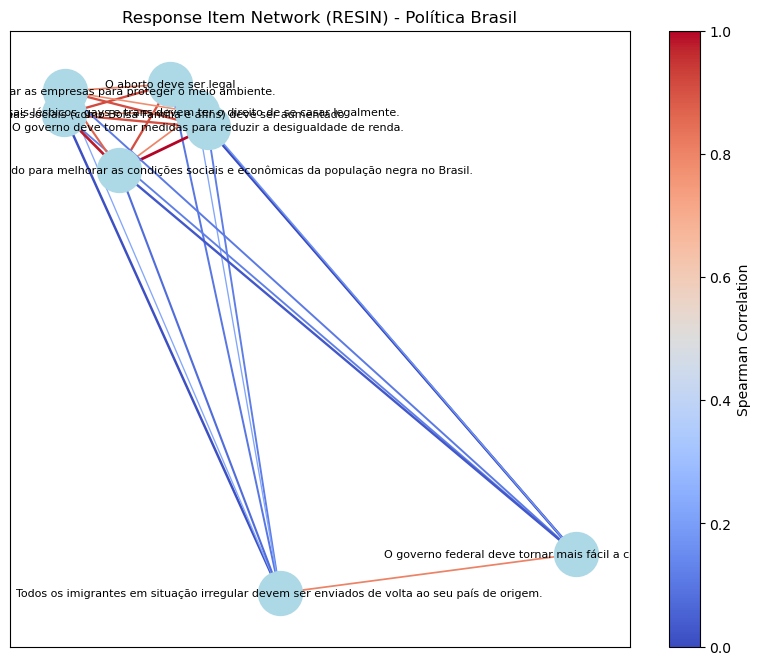

In [2]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
from scipy.stats import spearmanr

# Carregar dados
df = pd.read_csv("Política Brasil.csv")

# Selecionar apenas as colunas de itens (exclui timestamp, identificação política e comentários)
items = df.columns[2:-1]
data = df[items]

# Mapear respostas ordinais para números
mapping = {
    "Discordo Fortemente": 1,
    "Discordo Levemente": 2,
    "Neutro": 3,
    "Concordo Levemente": 4,
    "Concordo Fortemente": 5
}
data_num = data.replace(mapping)

# Calcular matriz de correlação (Spearman para ordinal)
corr_matrix, _ = spearmanr(data_num, axis=0)
corr_matrix = corr_matrix[:len(items), :len(items)]

# Construir grafo
G = nx.Graph()
for i, item_i in enumerate(items):
    for j, item_j in enumerate(items):
        if i < j:
            weight = corr_matrix[i, j]
            if abs(weight) > 0.2:  # threshold para clareza
                G.add_edge(item_i, item_j, weight=weight)

# Visualização
pos = nx.spring_layout(G, seed=42)
edges, weights = zip(*nx.get_edge_attributes(G, 'weight').items())

plt.figure(figsize=(10, 8))
nx.draw_networkx_nodes(G, pos, node_size=1000, node_color="lightblue")
nx.draw_networkx_edges(G, pos, edgelist=edges, width=[3*abs(w) for w in weights],
                       edge_color=weights, edge_cmap=plt.cm.coolwarm)
nx.draw_networkx_labels(G, pos, font_size=8)
plt.title("Response Item Network (RESIN) - Política Brasil")
plt.colorbar(plt.cm.ScalarMappable(cmap=plt.cm.coolwarm), label="Spearman Correlation")
plt.show()


/tmp/ipykernel_23996/2607122882.py:67: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(G, pos,
/tmp/ipykernel_23996/2607122882.py:75: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(plt.cm.ScalarMappable(cmap=plt.cm.coolwarm),


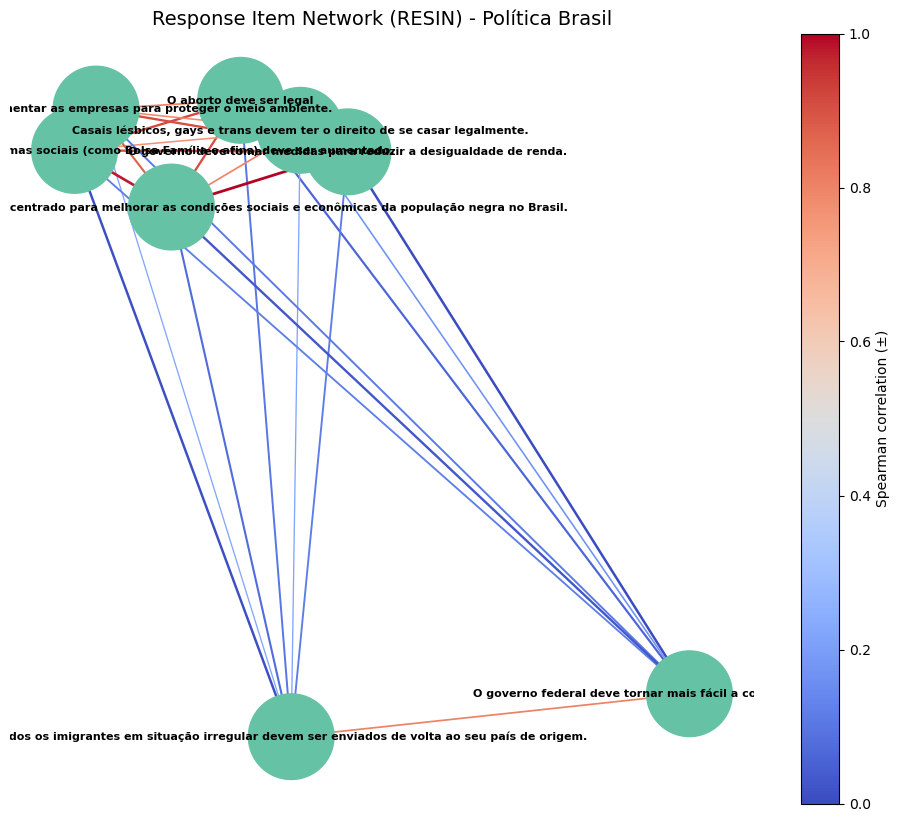

ValueError: Mixing dicts with non-Series may lead to ambiguous ordering.

In [3]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
from scipy.stats import spearmanr
from networkx.algorithms.community import greedy_modularity_communities

# === 1. Carregar dados ===
df = pd.read_csv("Política Brasil.csv")

# Selecionar apenas as colunas das perguntas (ignora timestamp, identificação política e comentários)
items = df.columns[2:-1]
data = df[items]

# Mapear respostas ordinais para escala 1-5
mapping = {
    "Discordo Fortemente": 1,
    "Discordo Levemente": 2,
    "Neutro": 3,
    "Concordo Levemente": 4,
    "Concordo Fortemente": 5
}
data_num = data.replace(mapping)

# Remover linhas incompletas
data_num = data_num.dropna()

# === 2. Correlação entre itens (Spearman para ordinal) ===
corr_matrix, _ = spearmanr(data_num, axis=0)
corr_matrix = corr_matrix[:len(items), :len(items)]

# === 3. Construir grafo com threshold ===
G = nx.Graph()
for i, item_i in enumerate(items):
    for j, item_j in enumerate(items):
        if i < j:
            weight = corr_matrix[i, j]
            if abs(weight) >= 0.25:  # threshold ajustável
                G.add_edge(item_i, item_j, weight=weight)

# === 4. Comunidades ===
communities = list(greedy_modularity_communities(G))
community_map = {}
for cid, comm in enumerate(communities):
    for node in comm:
        community_map[node] = cid

# === 5. Métricas de rede ===
degree_centrality = nx.degree_centrality(G)
betweenness_centrality = nx.betweenness_centrality(G, weight="weight")
closeness_centrality = nx.closeness_centrality(G)

# === 6. Visualização ===
pos = nx.spring_layout(G, seed=42, k=0.5)

plt.figure(figsize=(12, 10))

# Nós coloridos por comunidade
node_colors = [community_map[n] for n in G.nodes()]
nx.draw_networkx_nodes(G, pos,
                       node_size=[800 + 3000*degree_centrality[n] for n in G.nodes()],
                       node_color=node_colors, cmap=plt.cm.Set2)

# Arestas com espessura e cor pelo peso
edges = G.edges(data=True)
weights = [d['weight'] for _, _, d in edges]
nx.draw_networkx_edges(G, pos,
                       edgelist=edges,
                       width=[3*abs(w) for w in weights],
                       edge_color=weights, edge_cmap=plt.cm.coolwarm)

nx.draw_networkx_labels(G, pos, font_size=8, font_weight="bold")

plt.title("Response Item Network (RESIN) - Política Brasil", fontsize=14)
plt.colorbar(plt.cm.ScalarMappable(cmap=plt.cm.coolwarm),
             label="Spearman correlation (±)")
plt.axis("off")
plt.show()

# === 7. Relatório simples das métricas ===
metrics = pd.DataFrame({
    "Degree Centrality": degree_centrality,
    "Betweenness Centrality": betweenness_centrality,
    "Closeness Centrality": closeness_centrality,
    "Community": [community_map[n] for n in G.nodes()]
}).sort_values("Degree Centrality", ascending=False)

print(metrics)


/tmp/ipykernel_23996/701231488.py:71: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(


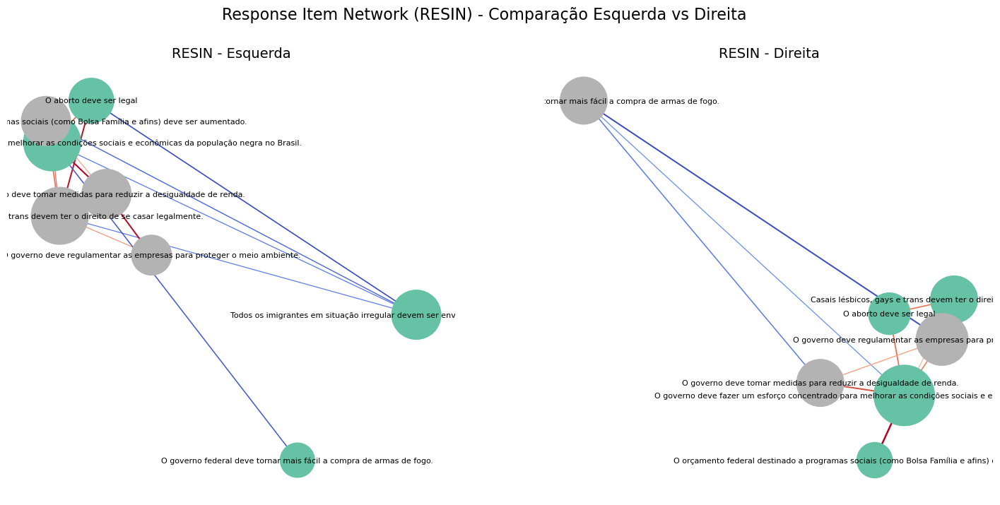

In [4]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
from scipy.stats import spearmanr
from networkx.algorithms.community import greedy_modularity_communities

# === Carregar dados ===
df = pd.read_csv("Política Brasil.csv")

# Coluna de identificação ideológica
id_col = "Primeiramente, me identifico politicamente como:"
items = df.columns[2:-1]  # só as questões (ignora timestamp e comentários)

# Mapear respostas ordinais para escala 1-5
mapping = {
    "Discordo Fortemente": 1,
    "Discordo Levemente": 2,
    "Neutro": 3,
    "Concordo Levemente": 4,
    "Concordo Fortemente": 5
}

# Função para gerar grafo de um grupo ideológico
def build_resin(data, label, threshold=0.25):
    data_num = data[items].replace(mapping).dropna()
    corr_matrix, _ = spearmanr(data_num, axis=0)
    corr_matrix = corr_matrix[:len(items), :len(items)]
    
    G = nx.Graph(group=label)
    for i, item_i in enumerate(items):
        for j, item_j in enumerate(items):
            if i < j:
                weight = corr_matrix[i, j]
                if abs(weight) >= threshold:
                    G.add_edge(item_i, item_j, weight=weight)
    
    return G, corr_matrix

# === Separar grupos ===
left_df = df[df[id_col].str.contains("Esquerda", case=False, na=False)]
right_df = df[df[id_col].str.contains("Direita", case=False, na=False)]

G_left, corr_left = build_resin(left_df, "Esquerda")
G_right, corr_right = build_resin(right_df, "Direita")

# === Visualização lado a lado ===
fig, axes = plt.subplots(1, 2, figsize=(18, 8))

for ax, (G, title) in zip(axes, [(G_left, "Esquerda"), (G_right, "Direita")]):
    pos = nx.spring_layout(G, seed=42, k=0.5)
    
    # Comunidades
    communities = list(greedy_modularity_communities(G))
    community_map = {n: cid for cid, comm in enumerate(communities) for n in comm}
    
    # Centralidade
    degree_centrality = nx.degree_centrality(G)
    
    # Nós
    node_colors = [community_map[n] for n in G.nodes()]
    nx.draw_networkx_nodes(
        G, pos, ax=ax,
        node_size=[800 + 3000*degree_centrality[n] for n in G.nodes()],
        node_color=node_colors, cmap=plt.cm.Set2
    )
    
    # Arestas
    edges = G.edges(data=True)
    weights = [d['weight'] for _, _, d in edges]
    nx.draw_networkx_edges(
        G, pos, ax=ax,
        edgelist=edges,
        width=[3*abs(w) for w in weights],
        edge_color=weights, edge_cmap=plt.cm.coolwarm
    )
    
    nx.draw_networkx_labels(G, pos, font_size=8, ax=ax)
    ax.set_title(f"RESIN - {title}", fontsize=14)
    ax.axis("off")

plt.suptitle("Response Item Network (RESIN) - Comparação Esquerda vs Direita", fontsize=16)
plt.show()


/tmp/ipykernel_23996/3103877681.py:71: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(
/tmp/ipykernel_23996/3103877681.py:106: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(G_diff, pos,
/tmp/ipykernel_23996/3103877681.py:114: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(plt.cm.ScalarMappable(cmap=plt.cm.bwr),


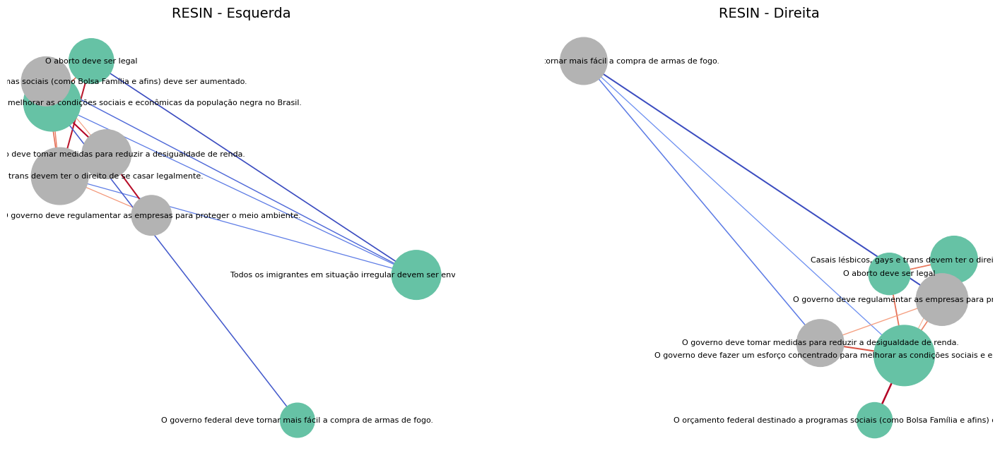

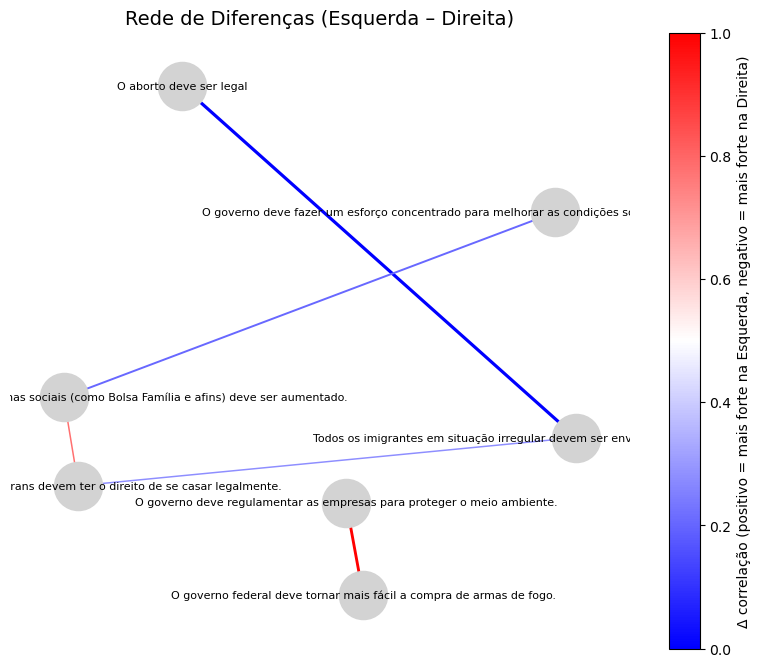

In [5]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
from scipy.stats import spearmanr
from networkx.algorithms.community import greedy_modularity_communities

# === Carregar dados ===
df = pd.read_csv("Política Brasil.csv")

# Coluna de identificação ideológica
id_col = "Primeiramente, me identifico politicamente como:"
items = df.columns[2:-1]  # só as questões (ignora timestamp e comentários)

# Mapear respostas ordinais para escala 1-5
mapping = {
    "Discordo Fortemente": 1,
    "Discordo Levemente": 2,
    "Neutro": 3,
    "Concordo Levemente": 4,
    "Concordo Fortemente": 5
}

# Função para gerar grafo de um grupo ideológico
def build_resin(data, label, threshold=0.25):
    data_num = data[items].replace(mapping).dropna()
    corr_matrix, _ = spearmanr(data_num, axis=0)
    corr_matrix = corr_matrix[:len(items), :len(items)]
    
    G = nx.Graph(group=label)
    for i, item_i in enumerate(items):
        for j, item_j in enumerate(items):
            if i < j:
                weight = corr_matrix[i, j]
                if abs(weight) >= threshold:
                    G.add_edge(item_i, item_j, weight=weight)
    
    return G, corr_matrix

# === Separar grupos ===
left_df = df[df[id_col].str.contains("Esquerda", case=False, na=False)]
right_df = df[df[id_col].str.contains("Direita", case=False, na=False)]

G_left, corr_left = build_resin(left_df, "Esquerda")
G_right, corr_right = build_resin(right_df, "Direita")

# === Visualização lado a lado ===
fig, axes = plt.subplots(1, 2, figsize=(18, 8))

for ax, (G, title) in zip(axes, [(G_left, "Esquerda"), (G_right, "Direita")]):
    pos = nx.spring_layout(G, seed=42, k=0.5)
    
    # Comunidades
    communities = list(greedy_modularity_communities(G))
    community_map = {n: cid for cid, comm in enumerate(communities) for n in comm}
    
    # Centralidade
    degree_centrality = nx.degree_centrality(G)
    
    # Nós
    node_colors = [community_map[n] for n in G.nodes()]
    nx.draw_networkx_nodes(
        G, pos, ax=ax,
        node_size=[800 + 3000*degree_centrality[n] for n in G.nodes()],
        node_color=node_colors, cmap=plt.cm.Set2
    )
    
    # Arestas
    edges = G.edges(data=True)
    weights = [d['weight'] for _, _, d in edges]
    nx.draw_networkx_edges(
        G, pos, ax=ax,
        edgelist=edges,
        width=[3*abs(w) for w in weights],
        edge_color=weights, edge_cmap=plt.cm.coolwarm
    )
    
    nx.draw_networkx_labels(G, pos, font_size=8, ax=ax)
    ax.set_title(f"RESIN - {title}", fontsize=14)
    ax.axis("off")

# === 1. Calcular diferença de correlações ===
diff_matrix = corr_left - corr_right

# === 2. Construir rede de diferenças ===
G_diff = nx.Graph()

threshold = 0.25  # você pode ajustar
for i, item_i in enumerate(items):
    for j, item_j in enumerate(items):
        if i < j:
            delta = diff_matrix[i, j]
            if abs(delta) >= threshold:
                G_diff.add_edge(item_i, item_j, weight=delta)

# === 3. Visualização da rede de diferenças ===
plt.figure(figsize=(10, 8))
pos = nx.spring_layout(G_diff, seed=42, k=0.5)

edges = G_diff.edges(data=True)
weights = [d['weight'] for _, _, d in edges]

nx.draw_networkx_nodes(G_diff, pos,
                       node_size=1200, node_color="lightgray")

nx.draw_networkx_edges(G_diff, pos,
                       edgelist=edges,
                       width=[4*abs(w) for w in weights],
                       edge_color=weights, edge_cmap=plt.cm.bwr)

nx.draw_networkx_labels(G_diff, pos, font_size=8)

plt.title("Rede de Diferenças (Esquerda – Direita)", fontsize=14)
plt.colorbar(plt.cm.ScalarMappable(cmap=plt.cm.bwr),
             label="Δ correlação (positivo = mais forte na Esquerda, negativo = mais forte na Direita)")
plt.axis("off")
plt.show()




/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/tmp/ipykernel_23996/949333189.py:85: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(
/tmp/ipykernel_23996/949333189.py:94: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* arg

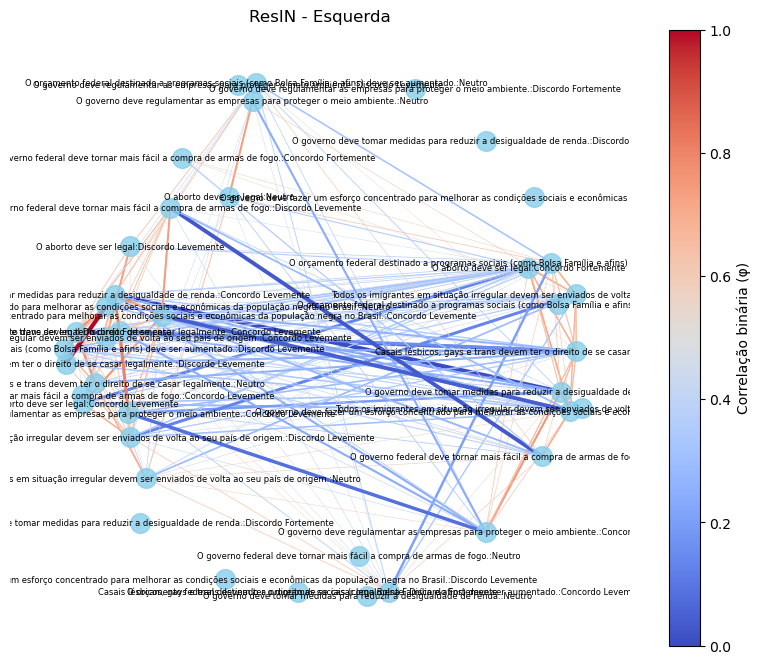

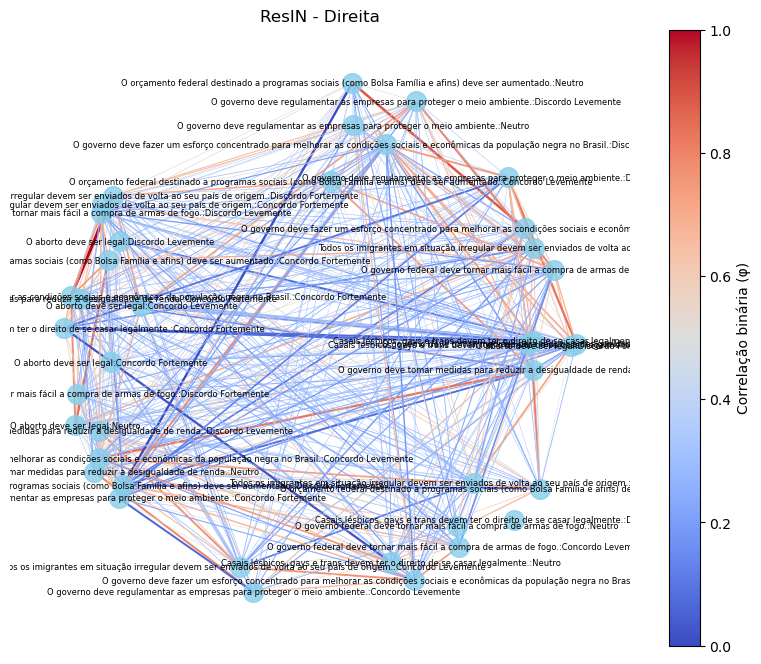

/tmp/ipykernel_23996/949333189.py:133: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(
/tmp/ipykernel_23996/949333189.py:142: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(plt.cm.ScalarMappable(cmap=plt.cm.bwr),


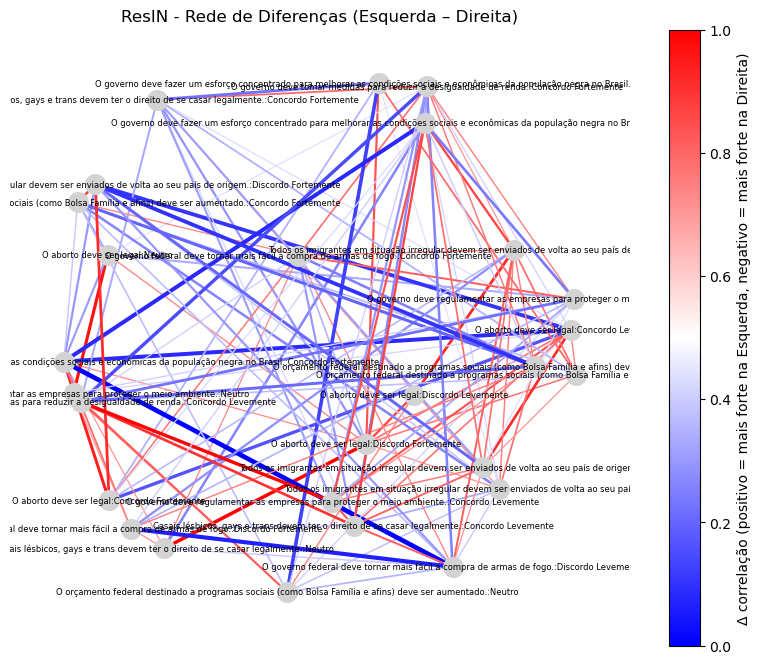

In [7]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

# ==============================
# 1. Carregar dados
# ==============================
df = pd.read_csv("Política Brasil.csv")

# Coluna de identificação política
group_col = "Primeiramente, me identifico politicamente como:"

# Perguntas (ignora timestamp e comentários finais)
items = df.columns[2:-1]

# Níveis de resposta no seu survey (ordem importa!)
response_levels = [
    "Discordo Fortemente",
    "Discordo Levemente",
    "Neutro",
    "Concordo Levemente",
    "Concordo Fortemente"
]

# ==============================
# 2. Funções auxiliares
# ==============================

def build_resin_responses(df, items, response_levels, group_mask=None, threshold=0.1):
    """
    Constrói uma rede ResIN onde cada nó = (item, nível de resposta).
    """
    if group_mask is not None:
        df = df[group_mask].copy()
    df = df.dropna(subset=items)
    
    # Criar matriz binária respondente × nós
    node_list = []
    bin_mat = []
    for item in items:
        for lvl in response_levels:
            node = (item, lvl)
            node_list.append(node)
            bin_mat.append((df[item] == lvl).astype(int).values)
    bin_mat = np.vstack(bin_mat).T
    
    # Correlação entre nós (phi coef ~ correlação de Pearson entre variáveis binárias)
    corr = np.corrcoef(bin_mat, rowvar=False)
    
    # Construir grafo
    G = nx.Graph()
    for node in node_list:
        G.add_node(node)
    n = len(node_list)
    for i in range(n):
        for j in range(i+1, n):
            w = corr[i, j]
            if not np.isnan(w) and abs(w) >= threshold:
                G.add_edge(node_list[i], node_list[j], weight=w)
    return G, corr, node_list


def layout_and_rotate(G, node_list):
    """
    Layout de força e rotação via PCA (alinha o eixo principal horizontal).
    """
    pos = nx.spring_layout(G, weight="weight", seed=42)
    coords = np.array([pos[n] for n in node_list])
    pca = PCA(n_components=2)
    coords2 = pca.fit_transform(coords)
    pos2 = {node_list[i]: tuple(coords2[i]) for i in range(len(node_list))}
    return pos2


def plot_resin(G, pos, title="ResIN"):
    """
    Plota a rede ResIN.
    """
    plt.figure(figsize=(10, 8))
    edges = G.edges(data=True)
    weights = [d['weight'] for _, _, d in edges]
    nx.draw_networkx_nodes(G, pos, node_size=200, node_color="skyblue", alpha=0.8)
    nx.draw_networkx_edges(
        G, pos,
        edgelist=edges,
        width=[3*abs(w) for w in weights],
        edge_color=weights, edge_cmap=plt.cm.coolwarm
    )
    labels = {n: f"{n[0]}:{n[1]}" for n in G.nodes()}
    nx.draw_networkx_labels(G, pos, labels, font_size=6)
    plt.title(title)
    plt.colorbar(plt.cm.ScalarMappable(cmap=plt.cm.coolwarm),
                 label="Correlação binária (φ)")
    plt.axis("off")
    plt.show()


# ==============================
# 3. Construir redes Esquerda vs Direita
# ==============================
mask_left = df[group_col].str.contains("Esquerda", case=False, na=False)
mask_right = df[group_col].str.contains("Direita", case=False, na=False)

G_left, corr_left, nodes = build_resin_responses(df, items, response_levels, mask_left)
G_right, corr_right, _ = build_resin_responses(df, items, response_levels, mask_right)

pos_left = layout_and_rotate(G_left, nodes)
pos_right = layout_and_rotate(G_right, nodes)

plot_resin(G_left, pos_left, "ResIN - Esquerda")
plot_resin(G_right, pos_right, "ResIN - Direita")

# ==============================
# 4. Rede de diferenças (Δ)
# ==============================
diff_matrix = corr_left - corr_right
G_diff = nx.Graph()
n = len(nodes)
for i in range(n):
    for j in range(i+1, n):
        delta = diff_matrix[i, j]
        if not np.isnan(delta) and abs(delta) >= 0.2:
            G_diff.add_edge(nodes[i], nodes[j], weight=delta)

pos_diff = layout_and_rotate(G_diff, list(G_diff.nodes()))

plt.figure(figsize=(10, 8))
edges = G_diff.edges(data=True)
weights = [d['weight'] for _, _, d in edges]
nx.draw_networkx_nodes(G_diff, pos_diff, node_size=200, node_color="lightgray")
nx.draw_networkx_edges(
    G_diff, pos_diff,
    edgelist=edges,
    width=[4*abs(w) for w in weights],
    edge_color=weights, edge_cmap=plt.cm.bwr
)
labels = {n: f"{n[0]}:{n[1]}" for n in G_diff.nodes()}
nx.draw_networkx_labels(G_diff, pos_diff, labels, font_size=6)
plt.title("ResIN - Rede de Diferenças (Esquerda – Direita)")
plt.colorbar(plt.cm.ScalarMappable(cmap=plt.cm.bwr),
             label="Δ correlação (positivo = mais forte na Esquerda, negativo = mais forte na Direita)")
plt.axis("off")
plt.show()


/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/tmp/ipykernel_23996/1196840341.py:85: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(
/tmp/ipykernel_23996/1196840341.py:94: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* a

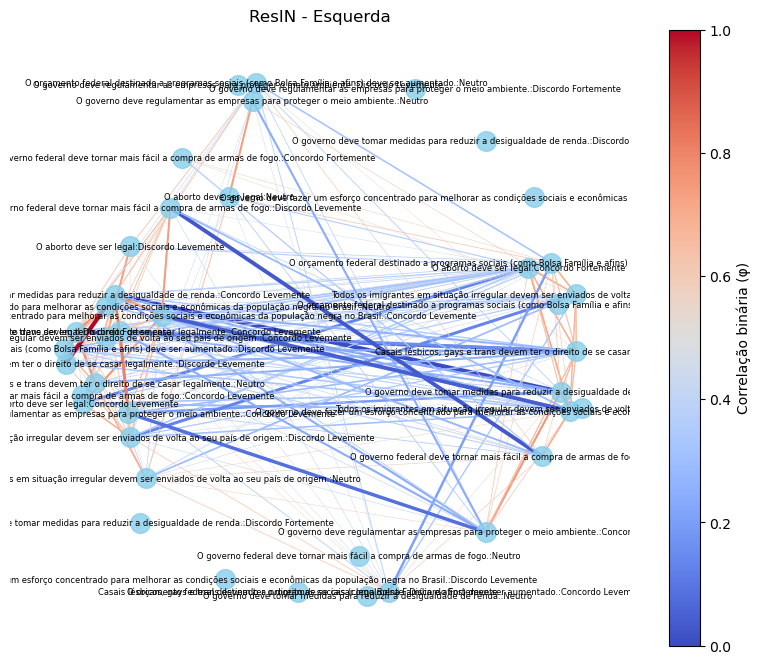

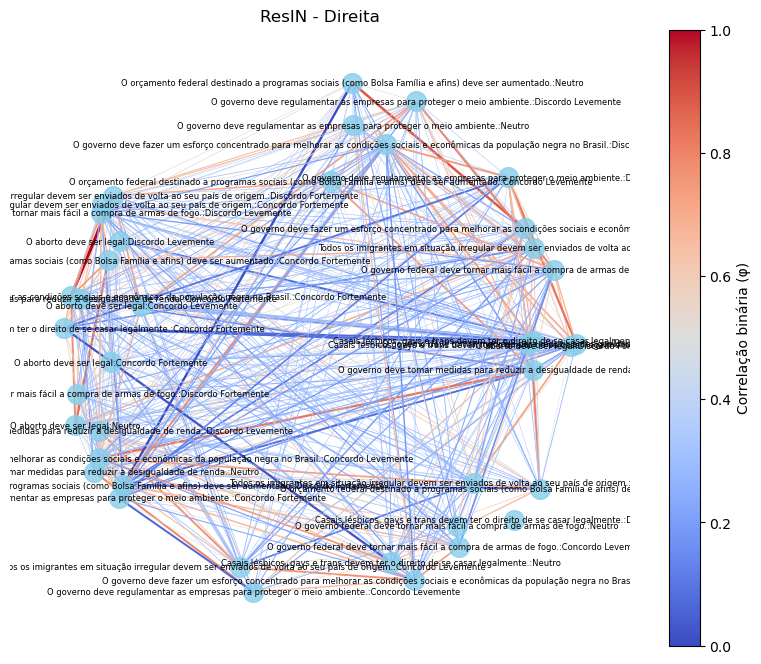

/tmp/ipykernel_23996/1196840341.py:136: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(
/tmp/ipykernel_23996/1196840341.py:147: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(


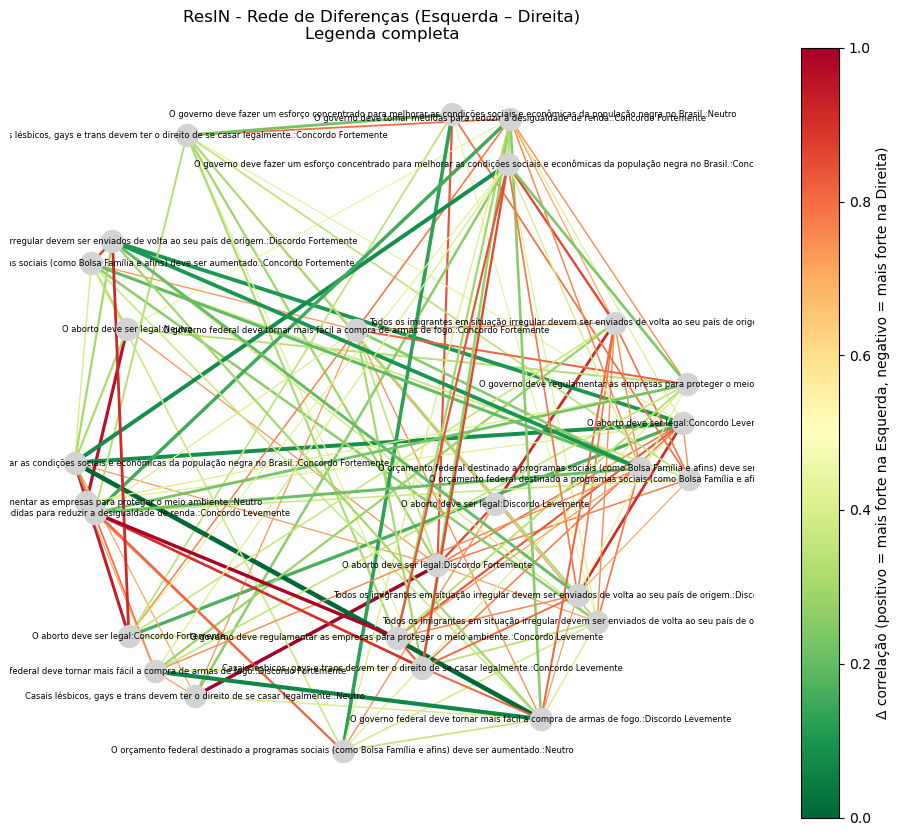

/tmp/ipykernel_23996/1196840341.py:160: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(
/tmp/ipykernel_23996/1196840341.py:171: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(


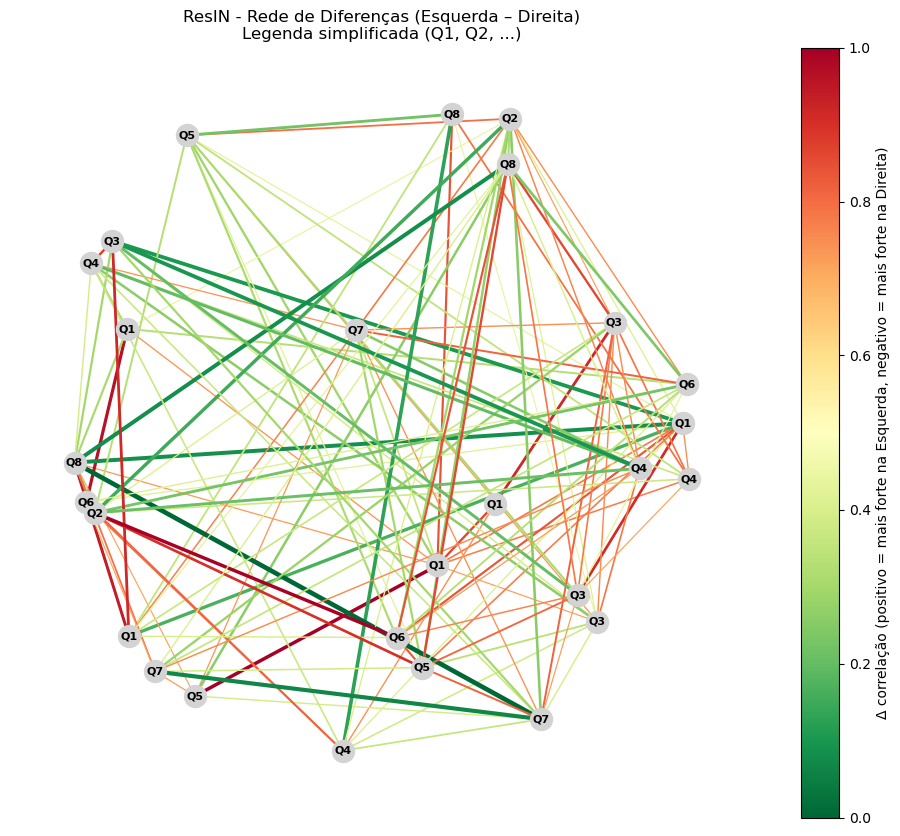

Mapa de referência (questão -> código usado no gráfico simplificado):

Q1 -> O aborto deve ser legal
Q2 -> O governo deve tomar medidas para reduzir a desigualdade de renda.
Q3 -> Todos os imigrantes em situação irregular devem ser enviados de volta ao seu país de origem.
Q4 -> O orçamento federal destinado a programas sociais (como Bolsa Família e afins) deve ser aumentado.
Q5 -> Casais lésbicos, gays e trans devem ter o direito de se casar legalmente.
Q6 -> O governo deve regulamentar as empresas para proteger o meio ambiente.
Q7 -> O governo federal deve tornar mais fácil a compra de armas de fogo.
Q8 -> O governo deve fazer um esforço concentrado para melhorar as condições sociais e econômicas da população negra no Brasil.


In [8]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

# ==============================
# 1. Carregar dados
# ==============================
df = pd.read_csv("Política Brasil.csv")

# Coluna de identificação política
group_col = "Primeiramente, me identifico politicamente como:"

# Perguntas (ignora timestamp e comentários finais)
items = df.columns[2:-1]

# Níveis de resposta no seu survey (ordem importa!)
response_levels = [
    "Discordo Fortemente",
    "Discordo Levemente",
    "Neutro",
    "Concordo Levemente",
    "Concordo Fortemente"
]

# ==============================
# 2. Funções auxiliares
# ==============================

def build_resin_responses(df, items, response_levels, group_mask=None, threshold=0.1):
    """
    Constrói uma rede ResIN onde cada nó = (item, nível de resposta).
    """
    if group_mask is not None:
        df = df[group_mask].copy()
    df = df.dropna(subset=items)
    
    # Criar matriz binária respondente × nós
    node_list = []
    bin_mat = []
    for item in items:
        for lvl in response_levels:
            node = (item, lvl)
            node_list.append(node)
            bin_mat.append((df[item] == lvl).astype(int).values)
    bin_mat = np.vstack(bin_mat).T
    
    # Correlação entre nós (phi coef ~ correlação de Pearson entre variáveis binárias)
    corr = np.corrcoef(bin_mat, rowvar=False)
    
    # Construir grafo
    G = nx.Graph()
    for node in node_list:
        G.add_node(node)
    n = len(node_list)
    for i in range(n):
        for j in range(i+1, n):
            w = corr[i, j]
            if not np.isnan(w) and abs(w) >= threshold:
                G.add_edge(node_list[i], node_list[j], weight=w)
    return G, corr, node_list


def layout_and_rotate(G, node_list):
    """
    Layout de força e rotação via PCA (alinha o eixo principal horizontal).
    """
    pos = nx.spring_layout(G, weight="weight", seed=42)
    coords = np.array([pos[n] for n in node_list])
    pca = PCA(n_components=2)
    coords2 = pca.fit_transform(coords)
    pos2 = {node_list[i]: tuple(coords2[i]) for i in range(len(node_list))}
    return pos2


def plot_resin(G, pos, title="ResIN"):
    """
    Plota a rede ResIN.
    """
    plt.figure(figsize=(10, 8))
    edges = G.edges(data=True)
    weights = [d['weight'] for _, _, d in edges]
    nx.draw_networkx_nodes(G, pos, node_size=200, node_color="skyblue", alpha=0.8)
    nx.draw_networkx_edges(
        G, pos,
        edgelist=edges,
        width=[3*abs(w) for w in weights],
        edge_color=weights, edge_cmap=plt.cm.coolwarm
    )
    labels = {n: f"{n[0]}:{n[1]}" for n in G.nodes()}
    nx.draw_networkx_labels(G, pos, labels, font_size=6)
    plt.title(title)
    plt.colorbar(plt.cm.ScalarMappable(cmap=plt.cm.coolwarm),
                 label="Correlação binária (φ)")
    plt.axis("off")
    plt.show()


# ==============================
# 3. Construir redes Esquerda vs Direita
# ==============================
mask_left = df[group_col].str.contains("Esquerda", case=False, na=False)
mask_right = df[group_col].str.contains("Direita", case=False, na=False)

G_left, corr_left, nodes = build_resin_responses(df, items, response_levels, mask_left)
G_right, corr_right, _ = build_resin_responses(df, items, response_levels, mask_right)

pos_left = layout_and_rotate(G_left, nodes)
pos_right = layout_and_rotate(G_right, nodes)

plot_resin(G_left, pos_left, "ResIN - Esquerda")
plot_resin(G_right, pos_right, "ResIN - Direita")

# ==============================
# 4. Rede de diferenças (Δ)
# ==============================
diff_matrix = corr_left - corr_right
G_diff = nx.Graph()
n = len(nodes)
for i in range(n):
    for j in range(i+1, n):
        delta = diff_matrix[i, j]
        if not np.isnan(delta) and abs(delta) >= 0.2:  # threshold
            G_diff.add_edge(nodes[i], nodes[j], weight=delta)

# Layout
pos_diff = layout_and_rotate(G_diff, list(G_diff.nodes()))

# === 4.1 Gráfico com legenda completa (Item : Resposta) ===
plt.figure(figsize=(12, 10))
edges = G_diff.edges(data=True)
weights = [d['weight'] for _, _, d in edges]

nx.draw_networkx_nodes(G_diff, pos_diff, node_size=250, node_color="lightgray")
nx.draw_networkx_edges(
    G_diff, pos_diff,
    edgelist=edges,
    width=[4*abs(w) for w in weights],
    edge_color=weights, edge_cmap=plt.cm.RdYlGn_r  # vermelho = esquerda, verde = direita
)

labels_full = {n: f"{n[0]}:{n[1]}" for n in G_diff.nodes()}
nx.draw_networkx_labels(G_diff, pos_diff, labels=labels_full, font_size=6)

plt.title("ResIN - Rede de Diferenças (Esquerda – Direita)\nLegenda completa")
plt.colorbar(
    plt.cm.ScalarMappable(cmap=plt.cm.RdYlGn_r),
    label="Δ correlação (positivo = mais forte na Esquerda, negativo = mais forte na Direita)"
)
plt.axis("off")
plt.show()

# === 4.2 Gráfico simplificado (somente numeração das questões) ===
# Criar mapa: questão -> Q1, Q2, ...
question_map = {item: f"Q{i+1}" for i, item in enumerate(items)}

plt.figure(figsize=(12, 10))
nx.draw_networkx_nodes(G_diff, pos_diff, node_size=250, node_color="lightgray")
nx.draw_networkx_edges(
    G_diff, pos_diff,
    edgelist=edges,
    width=[4*abs(w) for w in weights],
    edge_color=weights, edge_cmap=plt.cm.RdYlGn_r
)

labels_simplified = {n: f"{question_map[n[0]]}" for n in G_diff.nodes()}
nx.draw_networkx_labels(G_diff, pos_diff, labels=labels_simplified, font_size=8, font_weight="bold")

plt.title("ResIN - Rede de Diferenças (Esquerda – Direita)\nLegenda simplificada (Q1, Q2, ...)")
plt.colorbar(
    plt.cm.ScalarMappable(cmap=plt.cm.RdYlGn_r),
    label="Δ correlação (positivo = mais forte na Esquerda, negativo = mais forte na Direita)"
)
plt.axis("off")
plt.show()

# === 4.3 Imprimir mapa de referência questão <-> número ===
print("Mapa de referência (questão -> código usado no gráfico simplificado):\n")
for i, item in enumerate(items, start=1):
    print(f"Q{i} -> {item}")


/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/tmp/ipykernel_23996/4056776733.py:83: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(
/tmp/ipykernel_23996/4056776733.py:97: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* a

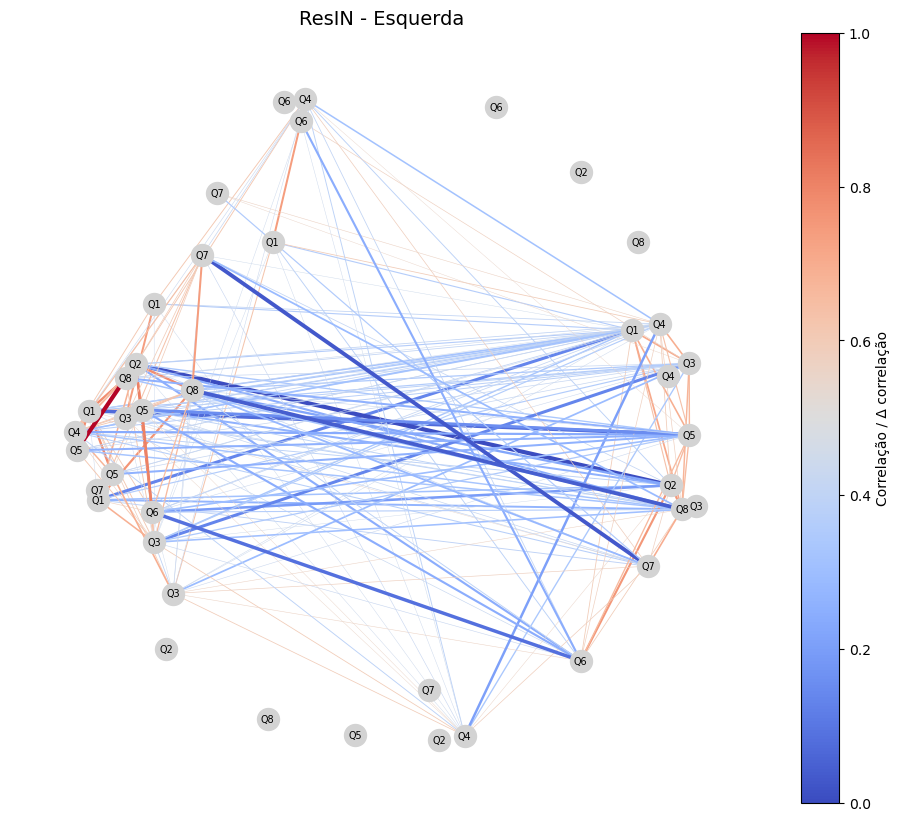

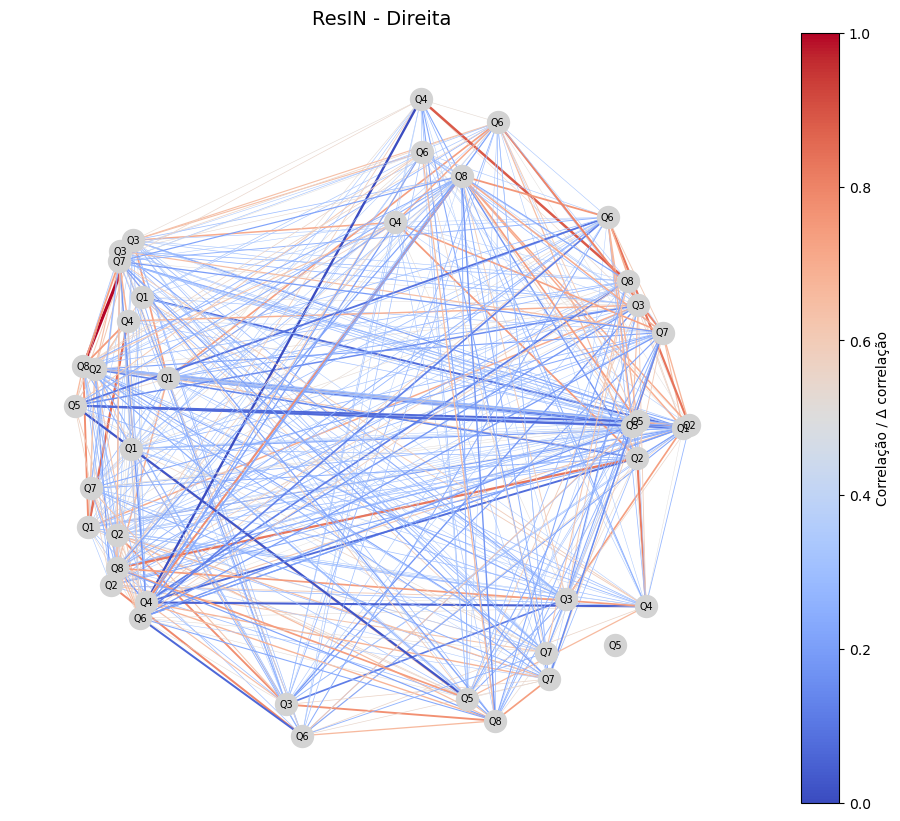

/tmp/ipykernel_23996/4056776733.py:83: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(
/tmp/ipykernel_23996/4056776733.py:97: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(


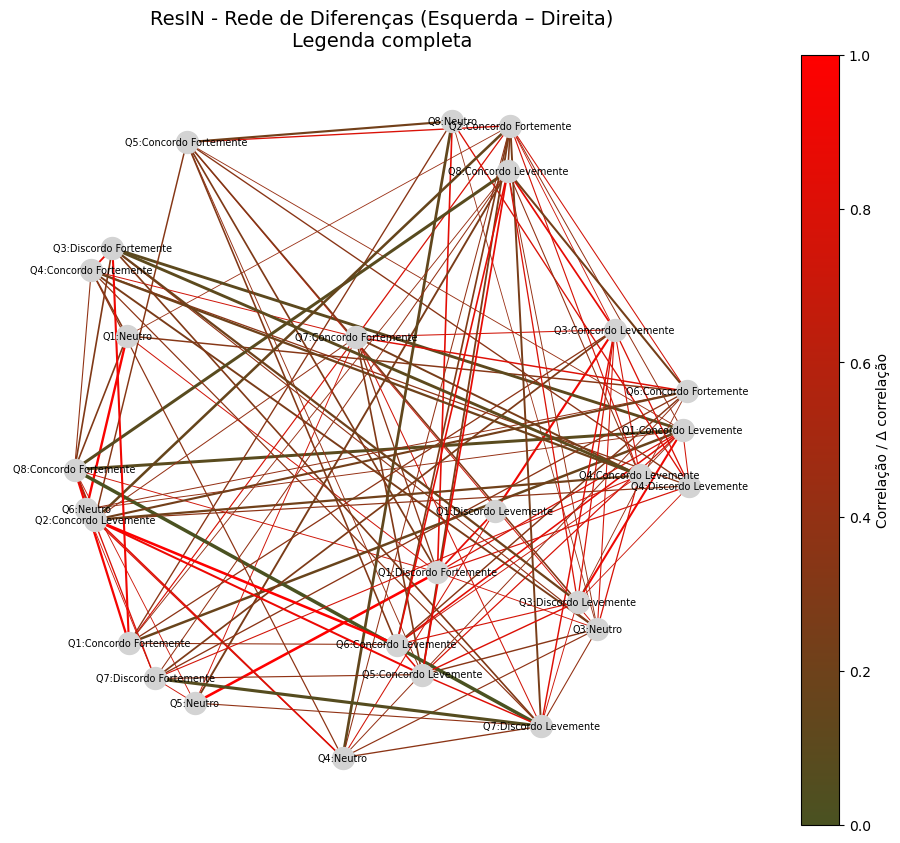

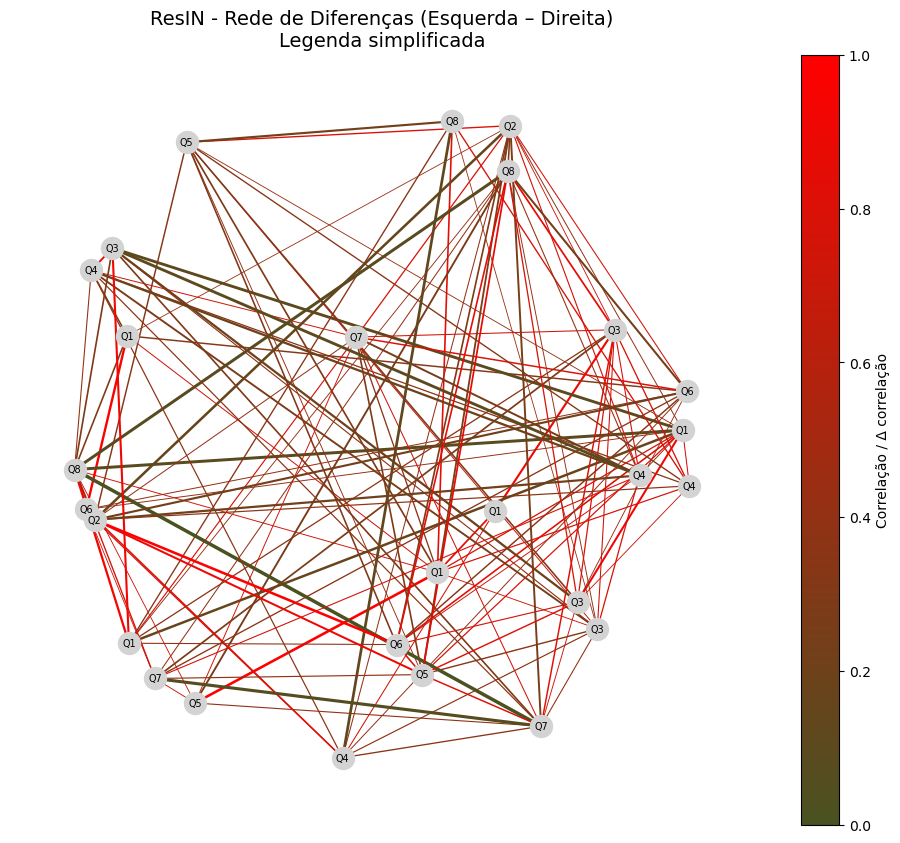


Mapa de referência (questão -> código Qn):

Q1 -> O aborto deve ser legal
Q2 -> O governo deve tomar medidas para reduzir a desigualdade de renda.
Q3 -> Todos os imigrantes em situação irregular devem ser enviados de volta ao seu país de origem.
Q4 -> O orçamento federal destinado a programas sociais (como Bolsa Família e afins) deve ser aumentado.
Q5 -> Casais lésbicos, gays e trans devem ter o direito de se casar legalmente.
Q6 -> O governo deve regulamentar as empresas para proteger o meio ambiente.
Q7 -> O governo federal deve tornar mais fácil a compra de armas de fogo.
Q8 -> O governo deve fazer um esforço concentrado para melhorar as condições sociais e econômicas da população negra no Brasil.


In [9]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from matplotlib.colors import LinearSegmentedColormap

# ==============================
# 1. Carregar dados
# ==============================
df = pd.read_csv("Política Brasil.csv")

# Coluna de identificação política
group_col = "Primeiramente, me identifico politicamente como:"

# Perguntas (ignora timestamp e comentários finais)
items = df.columns[2:-1]

# Criar mapa de referência questão -> Q1, Q2...
question_map = {item: f"Q{i+1}" for i, item in enumerate(items)}

# Níveis de resposta no seu survey (ordem importa!)
response_levels = [
    "Discordo Fortemente",
    "Discordo Levemente",
    "Neutro",
    "Concordo Levemente",
    "Concordo Fortemente"
]

# ==============================
# 2. Funções auxiliares
# ==============================

def build_resin_responses(df, items, response_levels, group_mask=None, threshold=0.1):
    """
    Constrói uma rede ResIN onde cada nó = (item, nível de resposta).
    """
    if group_mask is not None:
        df = df[group_mask].copy()
    df = df.dropna(subset=items)
    
    node_list = []
    bin_mat = []
    for item in items:
        for lvl in response_levels:
            node = (item, lvl)
            node_list.append(node)
            bin_mat.append((df[item] == lvl).astype(int).values)
    bin_mat = np.vstack(bin_mat).T
    
    corr = np.corrcoef(bin_mat, rowvar=False)
    
    G = nx.Graph()
    for node in node_list:
        G.add_node(node)
    n = len(node_list)
    for i in range(n):
        for j in range(i+1, n):
            w = corr[i, j]
            if not np.isnan(w) and abs(w) >= threshold:
                G.add_edge(node_list[i], node_list[j], weight=w)
    return G, corr, node_list


def layout_and_rotate(G, node_list):
    """Layout de força + rotação PCA para alinhar eixo principal horizontal."""
    pos = nx.spring_layout(G, weight="weight", seed=42)
    coords = np.array([pos[n] for n in node_list])
    pca = PCA(n_components=2)
    coords2 = pca.fit_transform(coords)
    pos2 = {node_list[i]: tuple(coords2[i]) for i in range(len(node_list))}
    return pos2


def plot_resin(G, pos, cmap, title="ResIN", simplified=True):
    """Plota rede ResIN com opção de rótulo simplificado (Q1, Q2...)."""
    plt.figure(figsize=(12, 10))
    edges = G.edges(data=True)
    weights = [d['weight'] for _, _, d in edges]

    nx.draw_networkx_nodes(G, pos, node_size=250, node_color="lightgray")
    nx.draw_networkx_edges(
        G, pos,
        edgelist=edges,
        width=[3*abs(w) for w in weights],
        edge_color=weights, edge_cmap=cmap
    )

    if simplified:
        labels = {n: f"{question_map[n[0]]}" for n in G.nodes()}
    else:
        labels = {n: f"{question_map[n[0]]}:{n[1]}" for n in G.nodes()}
    nx.draw_networkx_labels(G, pos, labels=labels, font_size=7)

    plt.title(title, fontsize=14)
    plt.colorbar(
        plt.cm.ScalarMappable(cmap=cmap),
        label="Correlação / Δ correlação"
    )
    plt.axis("off")
    plt.show()


# ==============================
# 3. Construir redes Esquerda vs Direita
# ==============================
mask_left = df[group_col].str.contains("Esquerda", case=False, na=False)
mask_right = df[group_col].str.contains("Direita", case=False, na=False)

G_left, corr_left, nodes = build_resin_responses(df, items, response_levels, mask_left)
G_right, corr_right, _ = build_resin_responses(df, items, response_levels, mask_right)

pos_left = layout_and_rotate(G_left, nodes)
pos_right = layout_and_rotate(G_right, nodes)

# Paleta padrão para redes individuais
cmap_standard = plt.cm.coolwarm

plot_resin(G_left, pos_left, cmap_standard, "ResIN - Esquerda", simplified=True)
plot_resin(G_right, pos_right, cmap_standard, "ResIN - Direita", simplified=True)

# ==============================
# 4. Rede de diferenças (Δ Esquerda – Direita)
# ==============================
diff_matrix = corr_left - corr_right
G_diff = nx.Graph()
n = len(nodes)
for i in range(n):
    for j in range(i+1, n):
        delta = diff_matrix[i, j]
        if not np.isnan(delta) and abs(delta) >= 0.2:
            G_diff.add_edge(nodes[i], nodes[j], weight=delta)

pos_diff = layout_and_rotate(G_diff, list(G_diff.nodes()))

# Criar colormap vermelho (esquerda) – verde militar (direita)
military_green = "#4B5320"
cdict = {
    "red":   ((0.0, 0.29, 0.29), (1.0, 1.0, 1.0)),
    "green": ((0.0, 0.32, 0.32), (1.0, 0.0, 0.0)),
    "blue":  ((0.0, 0.13, 0.13), (1.0, 0.0, 0.0)),
}
cmap_diff = LinearSegmentedColormap("RedMilGreen", cdict)

# === Gráfico com legenda completa ===
plot_resin(G_diff, pos_diff, cmap_diff,
           "ResIN - Rede de Diferenças (Esquerda – Direita)\nLegenda completa",
           simplified=False)

# === Gráfico com legenda simplificada (Q1, Q2...) ===
plot_resin(G_diff, pos_diff, cmap_diff,
           "ResIN - Rede de Diferenças (Esquerda – Direita)\nLegenda simplificada",
           simplified=True)

# ==============================
# 5. Imprimir mapa de referência
# ==============================
print("\nMapa de referência (questão -> código Qn):\n")
for i, item in enumerate(items, start=1):
    print(f"Q{i} -> {item}")


/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/tmp/ipykernel_23996/3903708980.py:81: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(
/tmp/ipykernel_23996/3903708980.py:95: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* a

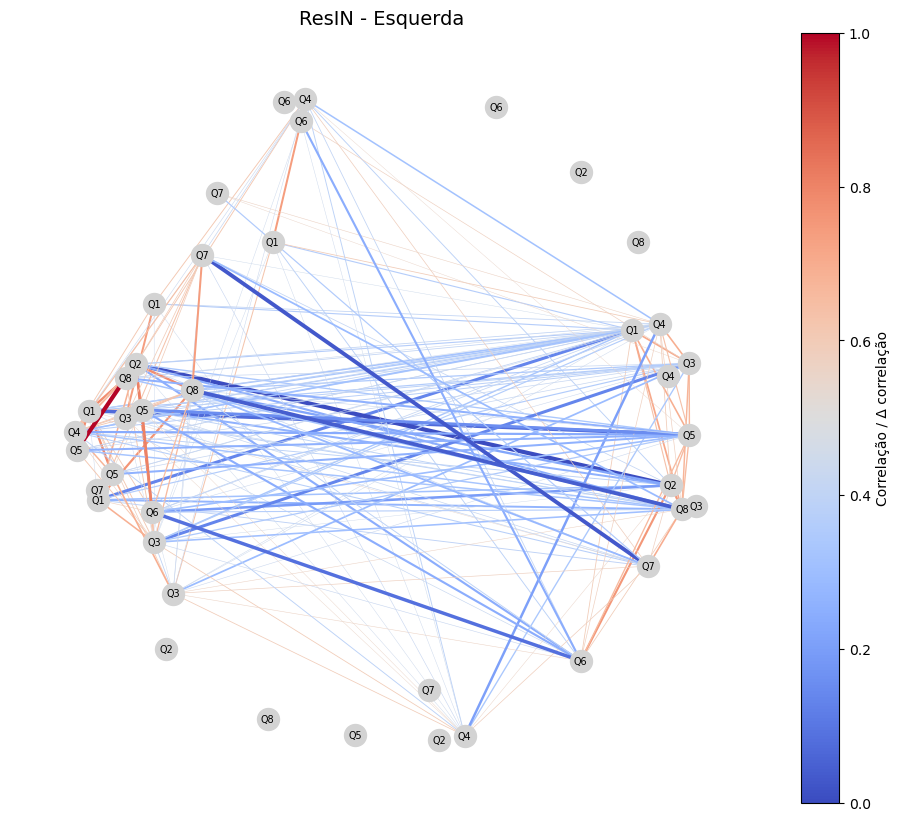

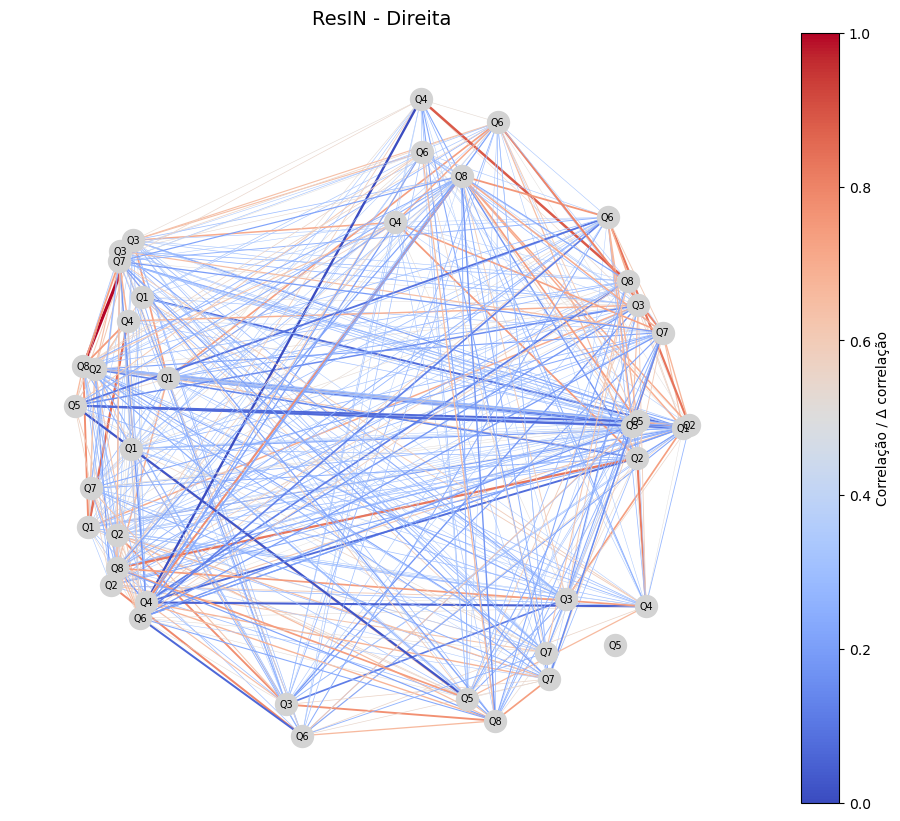

/tmp/ipykernel_23996/3903708980.py:81: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(
/tmp/ipykernel_23996/3903708980.py:95: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(


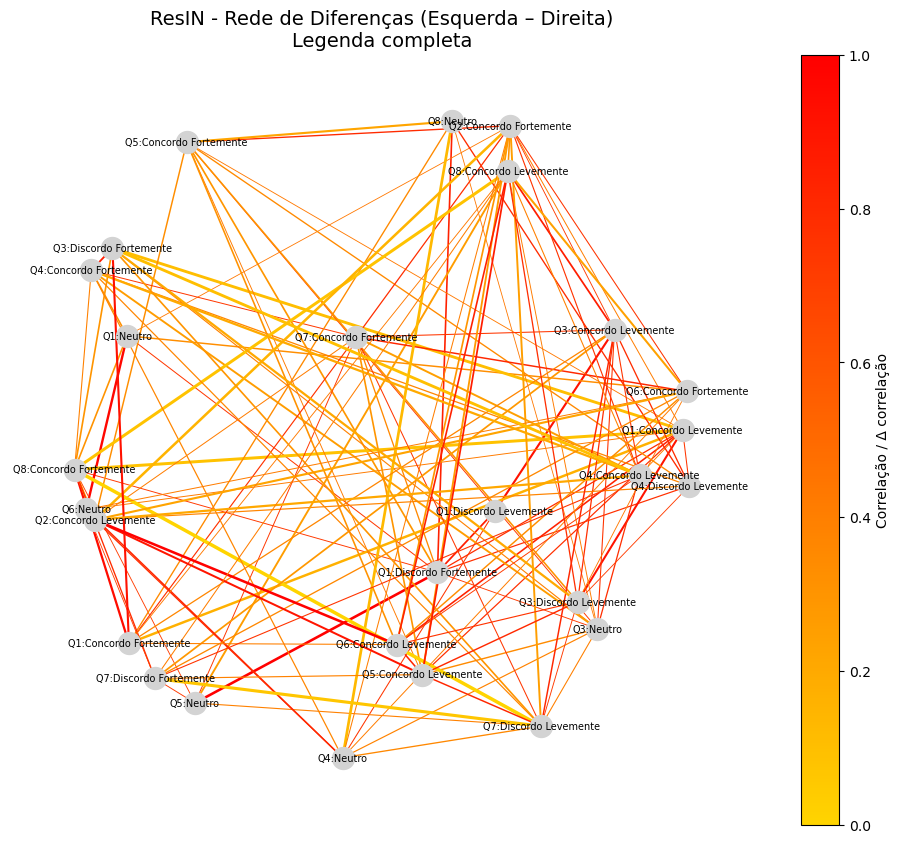

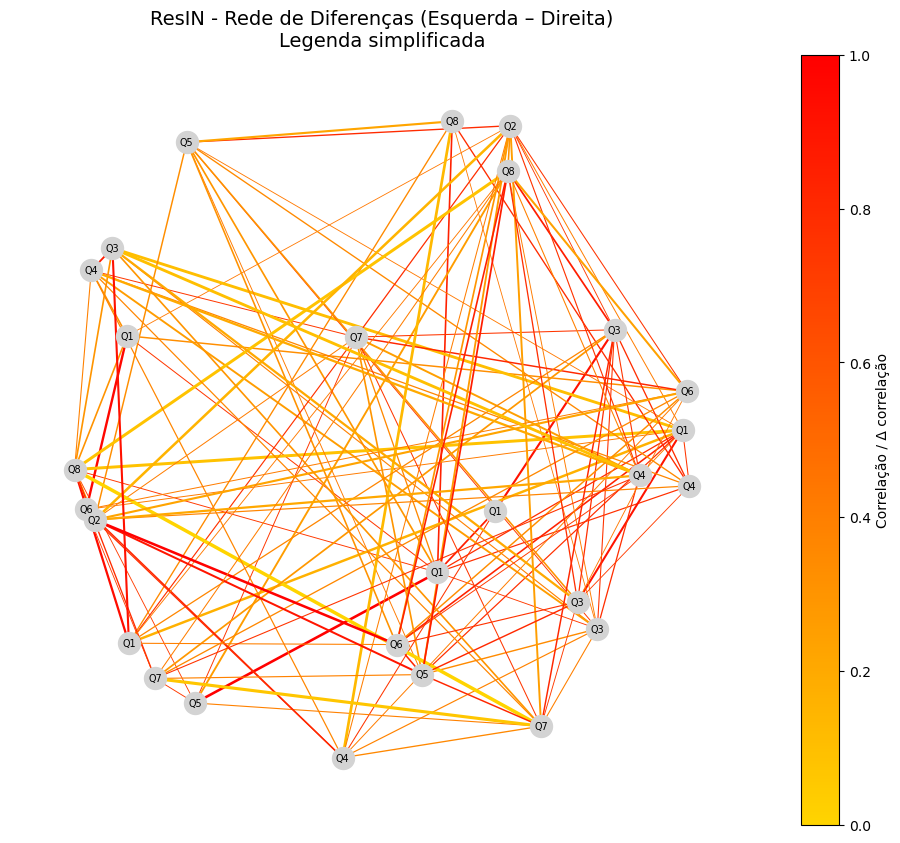


Mapa de referência (questão -> código Qn):

Q1 -> O aborto deve ser legal
Q2 -> O governo deve tomar medidas para reduzir a desigualdade de renda.
Q3 -> Todos os imigrantes em situação irregular devem ser enviados de volta ao seu país de origem.
Q4 -> O orçamento federal destinado a programas sociais (como Bolsa Família e afins) deve ser aumentado.
Q5 -> Casais lésbicos, gays e trans devem ter o direito de se casar legalmente.
Q6 -> O governo deve regulamentar as empresas para proteger o meio ambiente.
Q7 -> O governo federal deve tornar mais fácil a compra de armas de fogo.
Q8 -> O governo deve fazer um esforço concentrado para melhorar as condições sociais e econômicas da população negra no Brasil.


In [10]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from matplotlib.colors import LinearSegmentedColormap

# ==============================
# 1. Carregar dados
# ==============================
df = pd.read_csv("Política Brasil.csv")

# Coluna de identificação política
group_col = "Primeiramente, me identifico politicamente como:"

# Perguntas (ignora timestamp e comentários finais)
items = df.columns[2:-1]

# Criar mapa de referência questão -> Q1, Q2...
question_map = {item: f"Q{i+1}" for i, item in enumerate(items)}

# Níveis de resposta no seu survey (ordem importa!)
response_levels = [
    "Discordo Fortemente",
    "Discordo Levemente",
    "Neutro",
    "Concordo Levemente",
    "Concordo Fortemente"
]

# ==============================
# 2. Funções auxiliares
# ==============================

def build_resin_responses(df, items, response_levels, group_mask=None, threshold=0.1):
    """Constrói uma rede ResIN onde cada nó = (item, nível de resposta)."""
    if group_mask is not None:
        df = df[group_mask].copy()
    df = df.dropna(subset=items)
    
    node_list = []
    bin_mat = []
    for item in items:
        for lvl in response_levels:
            node = (item, lvl)
            node_list.append(node)
            bin_mat.append((df[item] == lvl).astype(int).values)
    bin_mat = np.vstack(bin_mat).T
    
    corr = np.corrcoef(bin_mat, rowvar=False)
    
    G = nx.Graph()
    for node in node_list:
        G.add_node(node)
    n = len(node_list)
    for i in range(n):
        for j in range(i+1, n):
            w = corr[i, j]
            if not np.isnan(w) and abs(w) >= threshold:
                G.add_edge(node_list[i], node_list[j], weight=w)
    return G, corr, node_list


def layout_and_rotate(G, node_list):
    """Layout de força + rotação PCA para alinhar eixo principal horizontal."""
    pos = nx.spring_layout(G, weight="weight", seed=42)
    coords = np.array([pos[n] for n in node_list])
    pca = PCA(n_components=2)
    coords2 = pca.fit_transform(coords)
    pos2 = {node_list[i]: tuple(coords2[i]) for i in range(len(node_list))}
    return pos2


def plot_resin(G, pos, cmap, title="ResIN", simplified=True):
    """Plota rede ResIN com opção de rótulo simplificado (Q1, Q2...)."""
    plt.figure(figsize=(12, 10))
    edges = G.edges(data=True)
    weights = [d['weight'] for _, _, d in edges]

    nx.draw_networkx_nodes(G, pos, node_size=250, node_color="lightgray")
    nx.draw_networkx_edges(
        G, pos,
        edgelist=edges,
        width=[3*abs(w) for w in weights],
        edge_color=weights, edge_cmap=cmap
    )

    if simplified:
        labels = {n: f"{question_map[n[0]]}" for n in G.nodes()}
    else:
        labels = {n: f"{question_map[n[0]]}:{n[1]}" for n in G.nodes()}
    nx.draw_networkx_labels(G, pos, labels=labels, font_size=7)

    plt.title(title, fontsize=14)
    plt.colorbar(
        plt.cm.ScalarMappable(cmap=cmap),
        label="Correlação / Δ correlação"
    )
    plt.axis("off")
    plt.show()


# ==============================
# 3. Construir redes Esquerda vs Direita
# ==============================
mask_left = df[group_col].str.contains("Esquerda", case=False, na=False)
mask_right = df[group_col].str.contains("Direita", case=False, na=False)

G_left, corr_left, nodes = build_resin_responses(df, items, response_levels, mask_left)
G_right, corr_right, _ = build_resin_responses(df, items, response_levels, mask_right)

pos_left = layout_and_rotate(G_left, nodes)
pos_right = layout_and_rotate(G_right, nodes)

# Paleta padrão para redes individuais
cmap_standard = plt.cm.coolwarm

plot_resin(G_left, pos_left, cmap_standard, "ResIN - Esquerda", simplified=True)
plot_resin(G_right, pos_right, cmap_standard, "ResIN - Direita", simplified=True)

# ==============================
# 4. Rede de diferenças (Δ Esquerda – Direita)
# ==============================
diff_matrix = corr_left - corr_right
G_diff = nx.Graph()
n = len(nodes)
for i in range(n):
    for j in range(i+1, n):
        delta = diff_matrix[i, j]
        if not np.isnan(delta) and abs(delta) >= 0.2:
            G_diff.add_edge(nodes[i], nodes[j], weight=delta)

pos_diff = layout_and_rotate(G_diff, list(G_diff.nodes()))

# Criar colormap vermelho (esquerda) – amarelo forte (direita)
strong_yellow = "#FFD300"  # amarelo vivo
cdict = {
    "red":   ((0.0, 1.0, 1.0), (1.0, 1.0, 1.0)),
    "green": ((0.0, 0.83, 0.83), (1.0, 0.0, 0.0)),
    "blue":  ((0.0, 0.0, 0.0), (1.0, 0.0, 0.0)),
}
cmap_diff = LinearSegmentedColormap("RedYellow", cdict)

# === Gráfico com legenda completa ===
plot_resin(G_diff, pos_diff, cmap_diff,
           "ResIN - Rede de Diferenças (Esquerda – Direita)\nLegenda completa",
           simplified=False)

# === Gráfico com legenda simplificada (Q1, Q2...) ===
plot_resin(G_diff, pos_diff, cmap_diff,
           "ResIN - Rede de Diferenças (Esquerda – Direita)\nLegenda simplificada",
           simplified=True)

# ==============================
# 5. Imprimir mapa de referência
# ==============================
print("\nMapa de referência (questão -> código Qn):\n")
for i, item in enumerate(items, start=1):
    print(f"Q{i} -> {item}")


/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/tmp/ipykernel_23996/1730412814.py:81: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(
/tmp/ipykernel_23996/1730412814.py:95: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* a

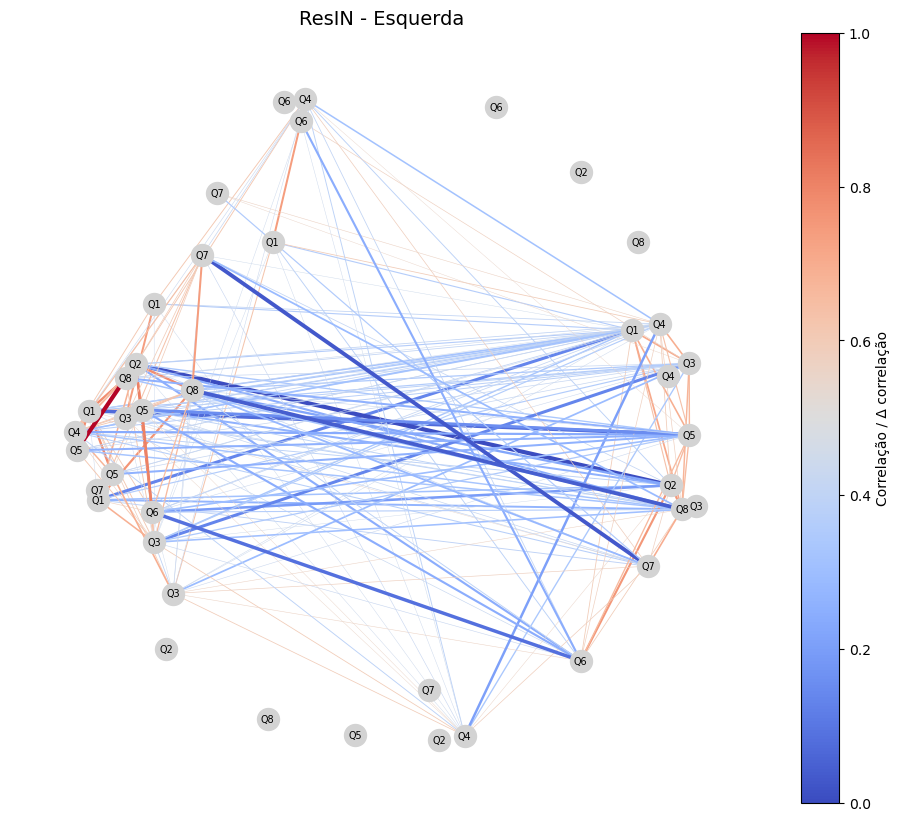

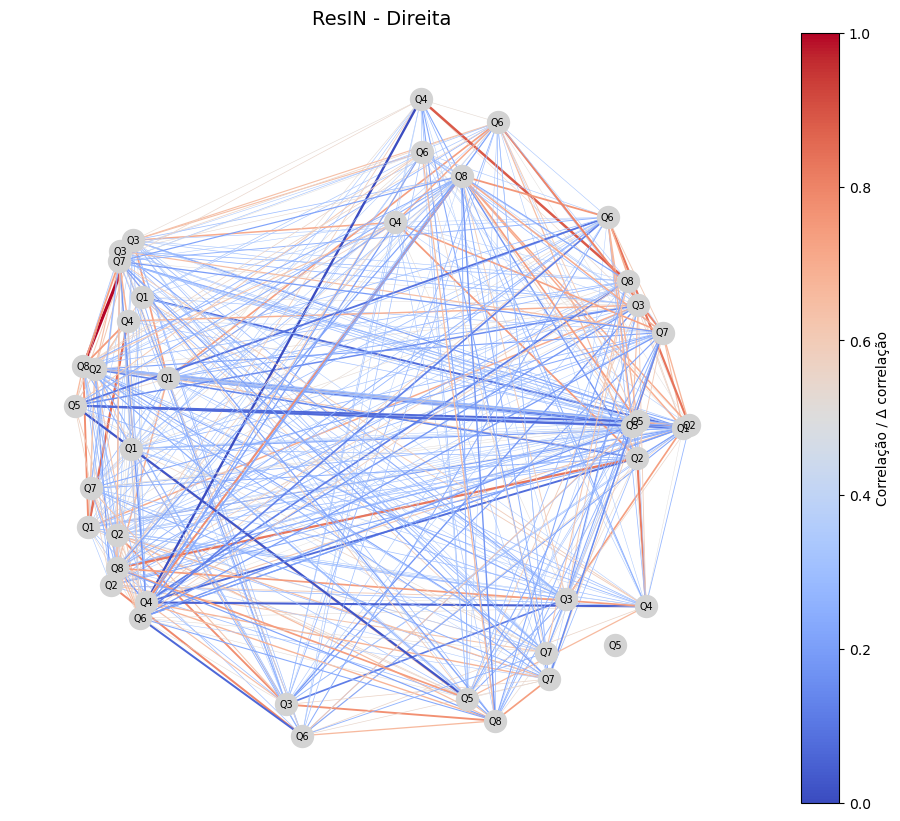

/tmp/ipykernel_23996/1730412814.py:81: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(
/tmp/ipykernel_23996/1730412814.py:95: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(


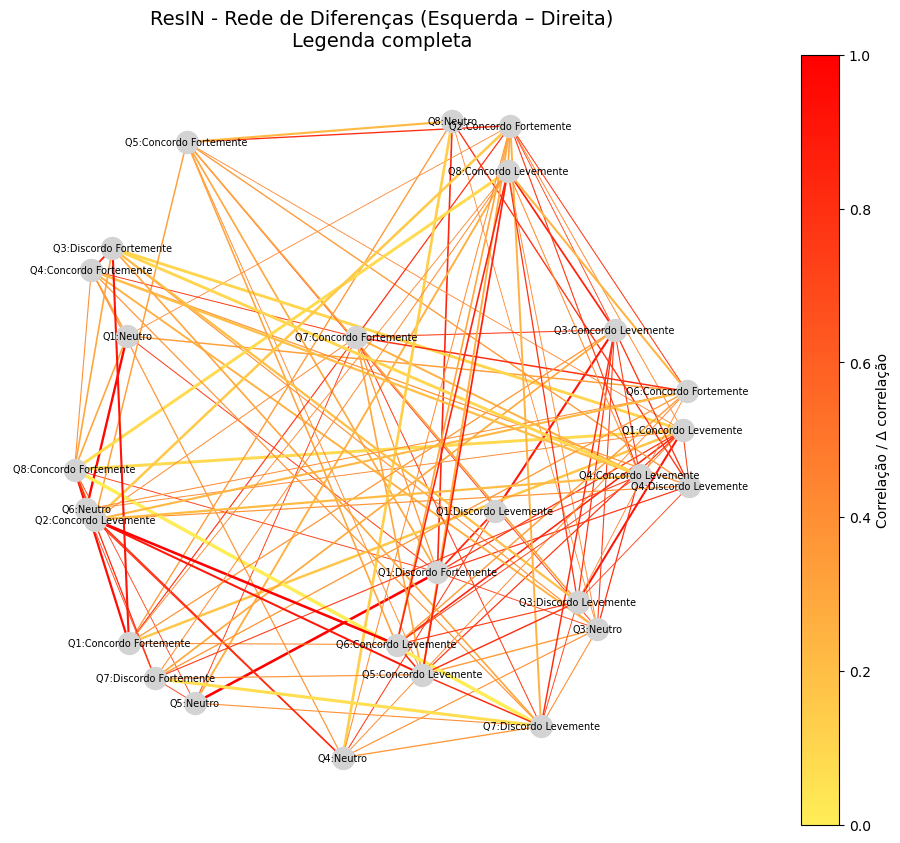

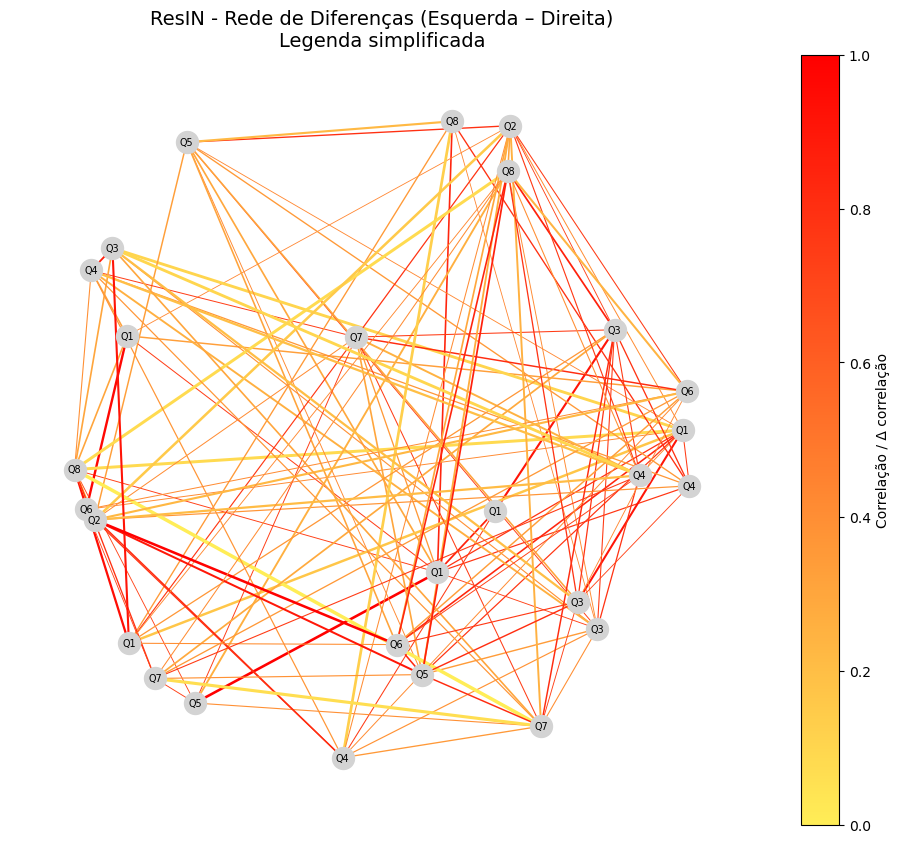


Mapa de referência (questão -> código Qn):

Q1 -> O aborto deve ser legal
Q2 -> O governo deve tomar medidas para reduzir a desigualdade de renda.
Q3 -> Todos os imigrantes em situação irregular devem ser enviados de volta ao seu país de origem.
Q4 -> O orçamento federal destinado a programas sociais (como Bolsa Família e afins) deve ser aumentado.
Q5 -> Casais lésbicos, gays e trans devem ter o direito de se casar legalmente.
Q6 -> O governo deve regulamentar as empresas para proteger o meio ambiente.
Q7 -> O governo federal deve tornar mais fácil a compra de armas de fogo.
Q8 -> O governo deve fazer um esforço concentrado para melhorar as condições sociais e econômicas da população negra no Brasil.


In [11]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from matplotlib.colors import LinearSegmentedColormap

# ==============================
# 1. Carregar dados
# ==============================
df = pd.read_csv("Política Brasil.csv")

# Coluna de identificação política
group_col = "Primeiramente, me identifico politicamente como:"

# Perguntas (ignora timestamp e comentários finais)
items = df.columns[2:-1]

# Criar mapa de referência questão -> Q1, Q2...
question_map = {item: f"Q{i+1}" for i, item in enumerate(items)}

# Níveis de resposta no seu survey (ordem importa!)
response_levels = [
    "Discordo Fortemente",
    "Discordo Levemente",
    "Neutro",
    "Concordo Levemente",
    "Concordo Fortemente"
]

# ==============================
# 2. Funções auxiliares
# ==============================

def build_resin_responses(df, items, response_levels, group_mask=None, threshold=0.1):
    """Constrói uma rede ResIN onde cada nó = (item, nível de resposta)."""
    if group_mask is not None:
        df = df[group_mask].copy()
    df = df.dropna(subset=items)
    
    node_list = []
    bin_mat = []
    for item in items:
        for lvl in response_levels:
            node = (item, lvl)
            node_list.append(node)
            bin_mat.append((df[item] == lvl).astype(int).values)
    bin_mat = np.vstack(bin_mat).T
    
    corr = np.corrcoef(bin_mat, rowvar=False)
    
    G = nx.Graph()
    for node in node_list:
        G.add_node(node)
    n = len(node_list)
    for i in range(n):
        for j in range(i+1, n):
            w = corr[i, j]
            if not np.isnan(w) and abs(w) >= threshold:
                G.add_edge(node_list[i], node_list[j], weight=w)
    return G, corr, node_list


def layout_and_rotate(G, node_list):
    """Layout de força + rotação PCA para alinhar eixo principal horizontal."""
    pos = nx.spring_layout(G, weight="weight", seed=42)
    coords = np.array([pos[n] for n in node_list])
    pca = PCA(n_components=2)
    coords2 = pca.fit_transform(coords)
    pos2 = {node_list[i]: tuple(coords2[i]) for i in range(len(node_list))}
    return pos2


def plot_resin(G, pos, cmap, title="ResIN", simplified=True):
    """Plota rede ResIN com opção de rótulo simplificado (Q1, Q2...)."""
    plt.figure(figsize=(12, 10))
    edges = G.edges(data=True)
    weights = [d['weight'] for _, _, d in edges]

    nx.draw_networkx_nodes(G, pos, node_size=250, node_color="lightgray")
    nx.draw_networkx_edges(
        G, pos,
        edgelist=edges,
        width=[3*abs(w) for w in weights],
        edge_color=weights, edge_cmap=cmap
    )

    if simplified:
        labels = {n: f"{question_map[n[0]]}" for n in G.nodes()}
    else:
        labels = {n: f"{question_map[n[0]]}:{n[1]}" for n in G.nodes()}
    nx.draw_networkx_labels(G, pos, labels=labels, font_size=7)

    plt.title(title, fontsize=14)
    plt.colorbar(
        plt.cm.ScalarMappable(cmap=cmap),
        label="Correlação / Δ correlação"
    )
    plt.axis("off")
    plt.show()


# ==============================
# 3. Construir redes Esquerda vs Direita
# ==============================
mask_left = df[group_col].str.contains("Esquerda", case=False, na=False)
mask_right = df[group_col].str.contains("Direita", case=False, na=False)

G_left, corr_left, nodes = build_resin_responses(df, items, response_levels, mask_left)
G_right, corr_right, _ = build_resin_responses(df, items, response_levels, mask_right)

pos_left = layout_and_rotate(G_left, nodes)
pos_right = layout_and_rotate(G_right, nodes)

# Paleta padrão para redes individuais
cmap_standard = plt.cm.coolwarm

plot_resin(G_left, pos_left, cmap_standard, "ResIN - Esquerda", simplified=True)
plot_resin(G_right, pos_right, cmap_standard, "ResIN - Direita", simplified=True)

# ==============================
# 4. Rede de diferenças (Δ Esquerda – Direita)
# ==============================
diff_matrix = corr_left - corr_right
G_diff = nx.Graph()
n = len(nodes)
for i in range(n):
    for j in range(i+1, n):
        delta = diff_matrix[i, j]
        if not np.isnan(delta) and abs(delta) >= 0.2:
            G_diff.add_edge(nodes[i], nodes[j], weight=delta)

pos_diff = layout_and_rotate(G_diff, list(G_diff.nodes()))

# Criar colormap vermelho (esquerda) – amarelo claro (direita, estilo CBF)
light_yellow = "#FFEE58"
cdict = {
    "red":   ((0.0, 1.0, 1.0), (1.0, 1.0, 1.0)),
    "green": ((0.0, 0.93, 0.93), (1.0, 0.0, 0.0)),
    "blue":  ((0.0, 0.34, 0.34), (1.0, 0.0, 0.0)),
}
cmap_diff = LinearSegmentedColormap("RedYellowLight", cdict)

# === Gráfico com legenda completa ===
plot_resin(G_diff, pos_diff, cmap_diff,
           "ResIN - Rede de Diferenças (Esquerda – Direita)\nLegenda completa",
           simplified=False)

# === Gráfico com legenda simplificada (Q1, Q2...) ===
plot_resin(G_diff, pos_diff, cmap_diff,
           "ResIN - Rede de Diferenças (Esquerda – Direita)\nLegenda simplificada",
           simplified=True)

# ==============================
# 5. Imprimir mapa de referência
# ==============================
print("\nMapa de referência (questão -> código Qn):\n")
for i, item in enumerate(items, start=1):
    print(f"Q{i} -> {item}")


/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/tmp/ipykernel_23996/1361385828.py:81: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(
/tmp/ipykernel_23996/1361385828.py:95: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* a

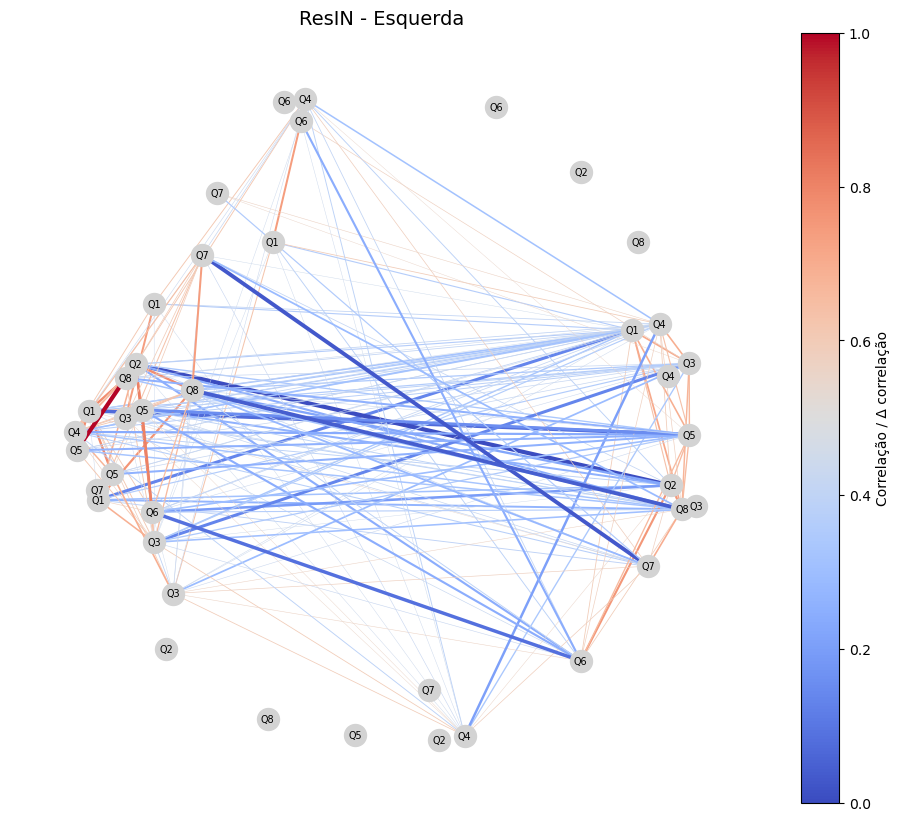

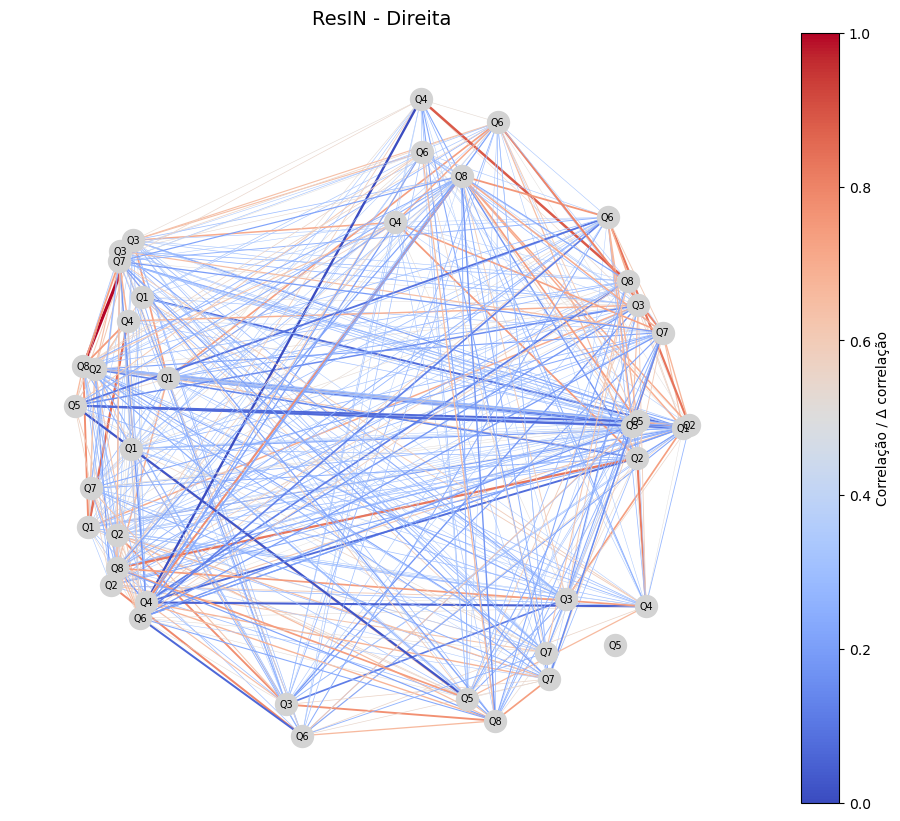

/tmp/ipykernel_23996/1361385828.py:81: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(
/tmp/ipykernel_23996/1361385828.py:95: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(


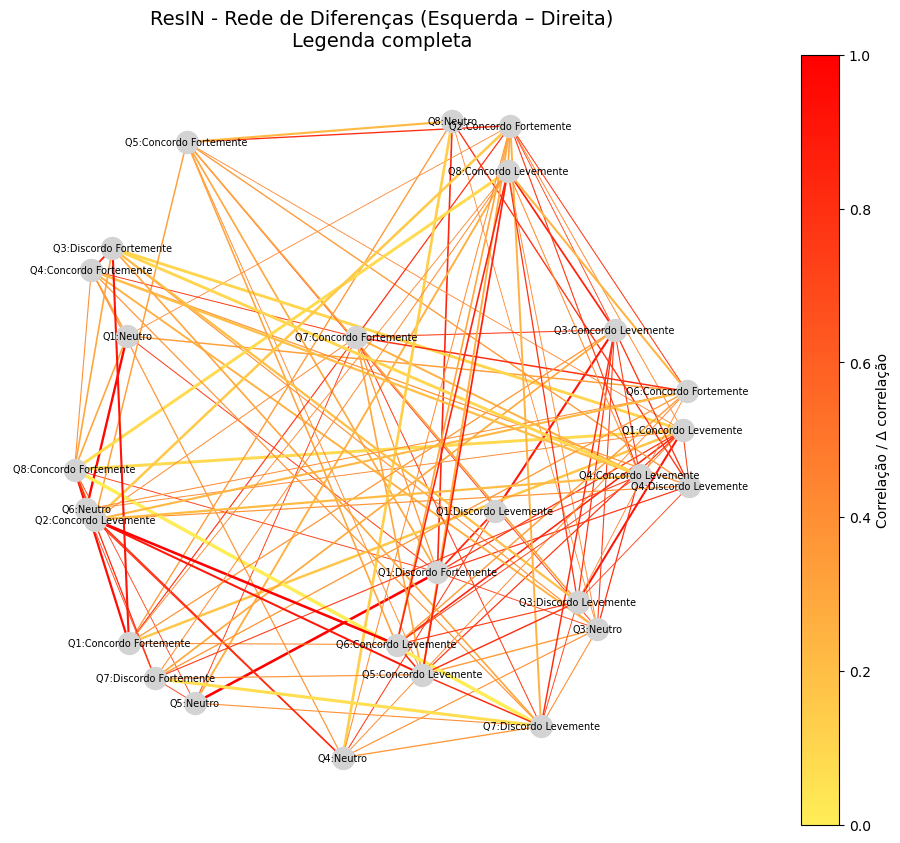

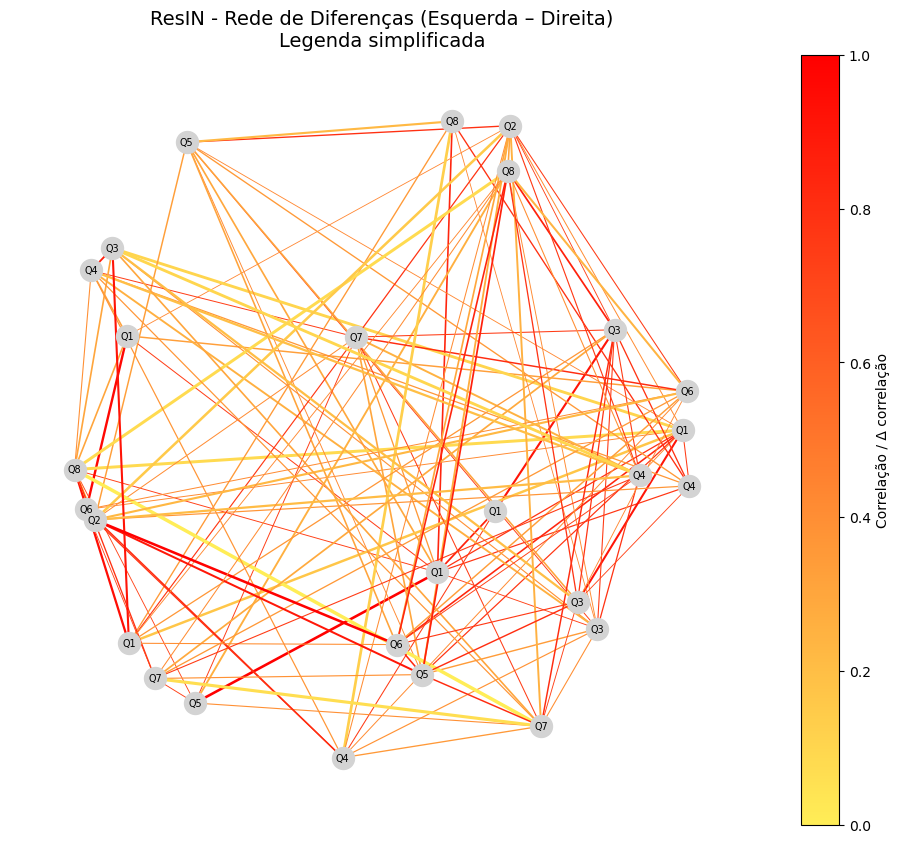


Mapa de referência (questão -> código Qn):

Q1 -> O aborto deve ser legal
Q2 -> O governo deve tomar medidas para reduzir a desigualdade de renda.
Q3 -> Todos os imigrantes em situação irregular devem ser enviados de volta ao seu país de origem.
Q4 -> O orçamento federal destinado a programas sociais (como Bolsa Família e afins) deve ser aumentado.
Q5 -> Casais lésbicos, gays e trans devem ter o direito de se casar legalmente.
Q6 -> O governo deve regulamentar as empresas para proteger o meio ambiente.
Q7 -> O governo federal deve tornar mais fácil a compra de armas de fogo.
Q8 -> O governo deve fazer um esforço concentrado para melhorar as condições sociais e econômicas da população negra no Brasil.

=== Homogeneidade ===
Esquerda -> densidade=0.254, força média=0.292, modularidade=1.244
Direita  -> densidade=0.642, força média=0.211, modularidade=1.061


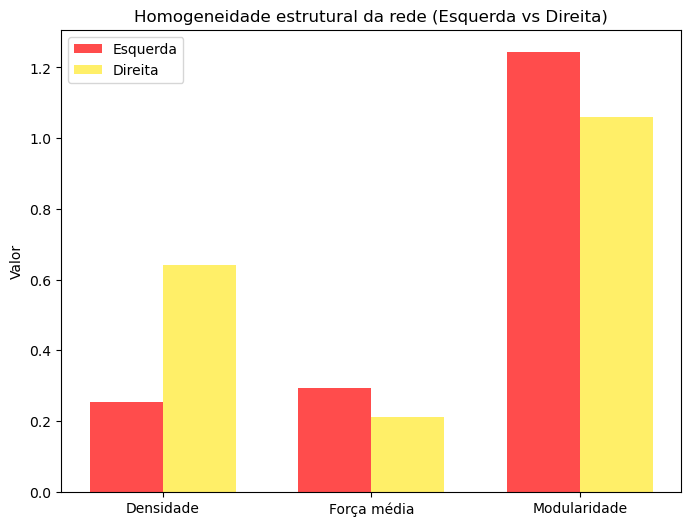

In [12]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from matplotlib.colors import LinearSegmentedColormap

# ==============================
# 1. Carregar dados
# ==============================
df = pd.read_csv("Política Brasil.csv")

# Coluna de identificação política
group_col = "Primeiramente, me identifico politicamente como:"

# Perguntas (ignora timestamp e comentários finais)
items = df.columns[2:-1]

# Criar mapa de referência questão -> Q1, Q2...
question_map = {item: f"Q{i+1}" for i, item in enumerate(items)}

# Níveis de resposta no seu survey (ordem importa!)
response_levels = [
    "Discordo Fortemente",
    "Discordo Levemente",
    "Neutro",
    "Concordo Levemente",
    "Concordo Fortemente"
]

# ==============================
# 2. Funções auxiliares
# ==============================

def build_resin_responses(df, items, response_levels, group_mask=None, threshold=0.1):
    """Constrói uma rede ResIN onde cada nó = (item, nível de resposta)."""
    if group_mask is not None:
        df = df[group_mask].copy()
    df = df.dropna(subset=items)
    
    node_list = []
    bin_mat = []
    for item in items:
        for lvl in response_levels:
            node = (item, lvl)
            node_list.append(node)
            bin_mat.append((df[item] == lvl).astype(int).values)
    bin_mat = np.vstack(bin_mat).T
    
    corr = np.corrcoef(bin_mat, rowvar=False)
    
    G = nx.Graph()
    for node in node_list:
        G.add_node(node)
    n = len(node_list)
    for i in range(n):
        for j in range(i+1, n):
            w = corr[i, j]
            if not np.isnan(w) and abs(w) >= threshold:
                G.add_edge(node_list[i], node_list[j], weight=w)
    return G, corr, node_list


def layout_and_rotate(G, node_list):
    """Layout de força + rotação PCA para alinhar eixo principal horizontal."""
    pos = nx.spring_layout(G, weight="weight", seed=42)
    coords = np.array([pos[n] for n in node_list])
    pca = PCA(n_components=2)
    coords2 = pca.fit_transform(coords)
    pos2 = {node_list[i]: tuple(coords2[i]) for i in range(len(node_list))}
    return pos2


def plot_resin(G, pos, cmap, title="ResIN", simplified=True):
    """Plota rede ResIN com opção de rótulo simplificado (Q1, Q2...)."""
    plt.figure(figsize=(12, 10))
    edges = G.edges(data=True)
    weights = [d['weight'] for _, _, d in edges]

    nx.draw_networkx_nodes(G, pos, node_size=250, node_color="lightgray")
    nx.draw_networkx_edges(
        G, pos,
        edgelist=edges,
        width=[3*abs(w) for w in weights],
        edge_color=weights, edge_cmap=cmap
    )

    if simplified:
        labels = {n: f"{question_map[n[0]]}" for n in G.nodes()}
    else:
        labels = {n: f"{question_map[n[0]]}:{n[1]}" for n in G.nodes()}
    nx.draw_networkx_labels(G, pos, labels=labels, font_size=7)

    plt.title(title, fontsize=14)
    plt.colorbar(
        plt.cm.ScalarMappable(cmap=cmap),
        label="Correlação / Δ correlação"
    )
    plt.axis("off")
    plt.show()


# ==============================
# 3. Construir redes Esquerda vs Direita
# ==============================
mask_left = df[group_col].str.contains("Esquerda", case=False, na=False)
mask_right = df[group_col].str.contains("Direita", case=False, na=False)

G_left, corr_left, nodes = build_resin_responses(df, items, response_levels, mask_left)
G_right, corr_right, _ = build_resin_responses(df, items, response_levels, mask_right)

pos_left = layout_and_rotate(G_left, nodes)
pos_right = layout_and_rotate(G_right, nodes)

# Paleta padrão para redes individuais
cmap_standard = plt.cm.coolwarm

plot_resin(G_left, pos_left, cmap_standard, "ResIN - Esquerda", simplified=True)
plot_resin(G_right, pos_right, cmap_standard, "ResIN - Direita", simplified=True)

# ==============================
# 4. Rede de diferenças (Δ Esquerda – Direita)
# ==============================
diff_matrix = corr_left - corr_right
G_diff = nx.Graph()
n = len(nodes)
for i in range(n):
    for j in range(i+1, n):
        delta = diff_matrix[i, j]
        if not np.isnan(delta) and abs(delta) >= 0.2:
            G_diff.add_edge(nodes[i], nodes[j], weight=delta)

pos_diff = layout_and_rotate(G_diff, list(G_diff.nodes()))

# Criar colormap vermelho (esquerda) – amarelo claro (direita, estilo CBF)
light_yellow = "#FFEE58"
cdict = {
    "red":   ((0.0, 1.0, 1.0), (1.0, 1.0, 1.0)),
    "green": ((0.0, 0.93, 0.93), (1.0, 0.0, 0.0)),
    "blue":  ((0.0, 0.34, 0.34), (1.0, 0.0, 0.0)),
}
cmap_diff = LinearSegmentedColormap("RedYellowLight", cdict)

# === Gráfico com legenda completa ===
plot_resin(G_diff, pos_diff, cmap_diff,
           "ResIN - Rede de Diferenças (Esquerda – Direita)\nLegenda completa",
           simplified=False)

# === Gráfico com legenda simplificada (Q1, Q2...) ===
plot_resin(G_diff, pos_diff, cmap_diff,
           "ResIN - Rede de Diferenças (Esquerda – Direita)\nLegenda simplificada",
           simplified=True)

# ==============================
# 5. Imprimir mapa de referência
# ==============================
print("\nMapa de referência (questão -> código Qn):\n")
for i, item in enumerate(items, start=1):
    print(f"Q{i} -> {item}")

# ==============================
# 6. Homogeneidade: Esquerda vs Direita
# ==============================

def network_homogeneity(G):
    """Calcula métricas de homogeneidade de uma rede ResIN."""
    n = len(G.nodes())
    m = len(G.edges())
    density = nx.density(G)
    avg_strength = np.mean([abs(d['weight']) for _, _, d in G.edges(data=True)]) if m > 0 else 0
    # Comunidades
    if m > 0:
        communities = nx.algorithms.community.greedy_modularity_communities(G, weight="weight")
        modularity = nx.algorithms.community.modularity(G, communities, weight="weight")
    else:
        modularity = 0
    return density, avg_strength, modularity

# Calcular métricas para Esquerda e Direita
density_left, strength_left, modularity_left = network_homogeneity(G_left)
density_right, strength_right, modularity_right = network_homogeneity(G_right)

# Mostrar no terminal
print("\n=== Homogeneidade ===")
print(f"Esquerda -> densidade={density_left:.3f}, força média={strength_left:.3f}, modularidade={modularity_left:.3f}")
print(f"Direita  -> densidade={density_right:.3f}, força média={strength_right:.3f}, modularidade={modularity_right:.3f}")

# === 4º gráfico: comparação lado a lado ===
labels = ["Densidade", "Força média", "Modularidade"]
esquerda_vals = [density_left, strength_left, modularity_left]
direita_vals = [density_right, strength_right, modularity_right]

x = np.arange(len(labels))
width = 0.35

plt.figure(figsize=(8,6))
plt.bar(x - width/2, esquerda_vals, width, label="Esquerda", color="red", alpha=0.7)
plt.bar(x + width/2, direita_vals, width, label="Direita", color="#FFEE58", alpha=0.9)  # amarelo claro CBF
plt.xticks(x, labels)
plt.ylabel("Valor")
plt.title("Homogeneidade estrutural da rede (Esquerda vs Direita)")
plt.legend()
plt.show()


/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/tmp/ipykernel_23996/4002932313.py:85: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(
/tmp/ipykernel_23996/4002932313.py:99: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* a

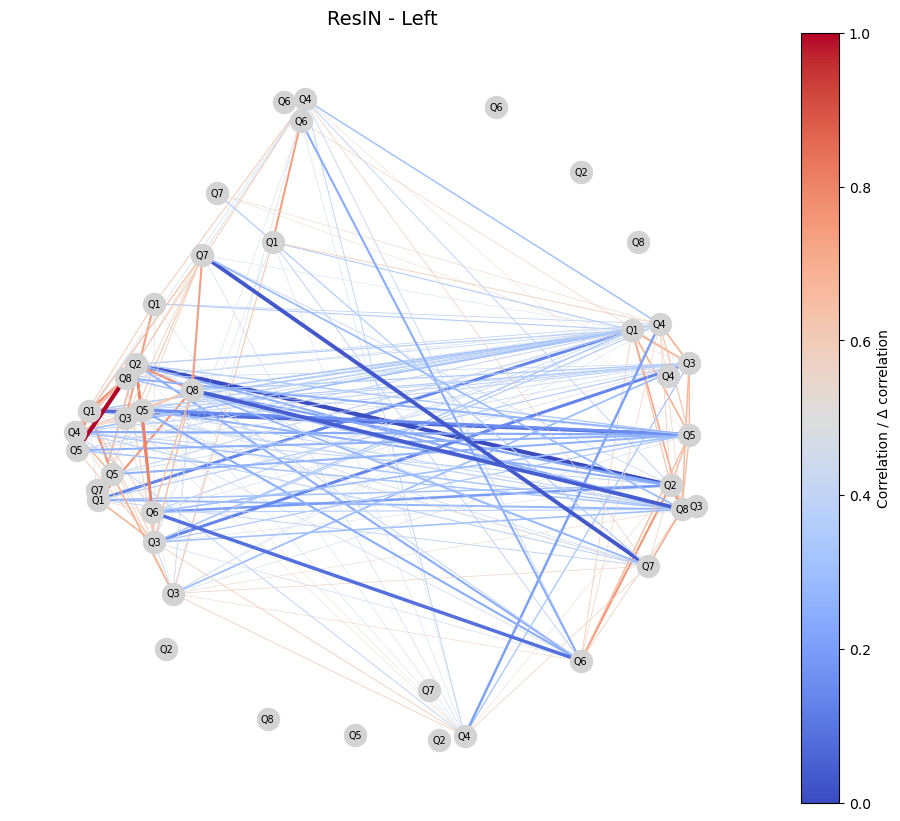

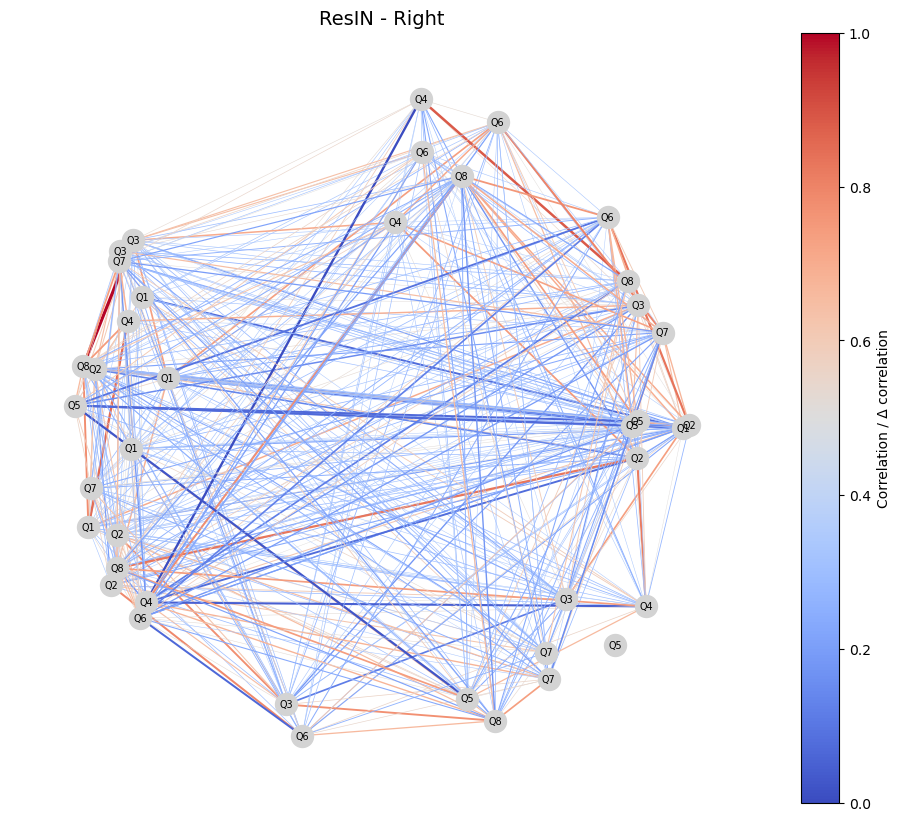

/tmp/ipykernel_23996/4002932313.py:85: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(
/tmp/ipykernel_23996/4002932313.py:99: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(


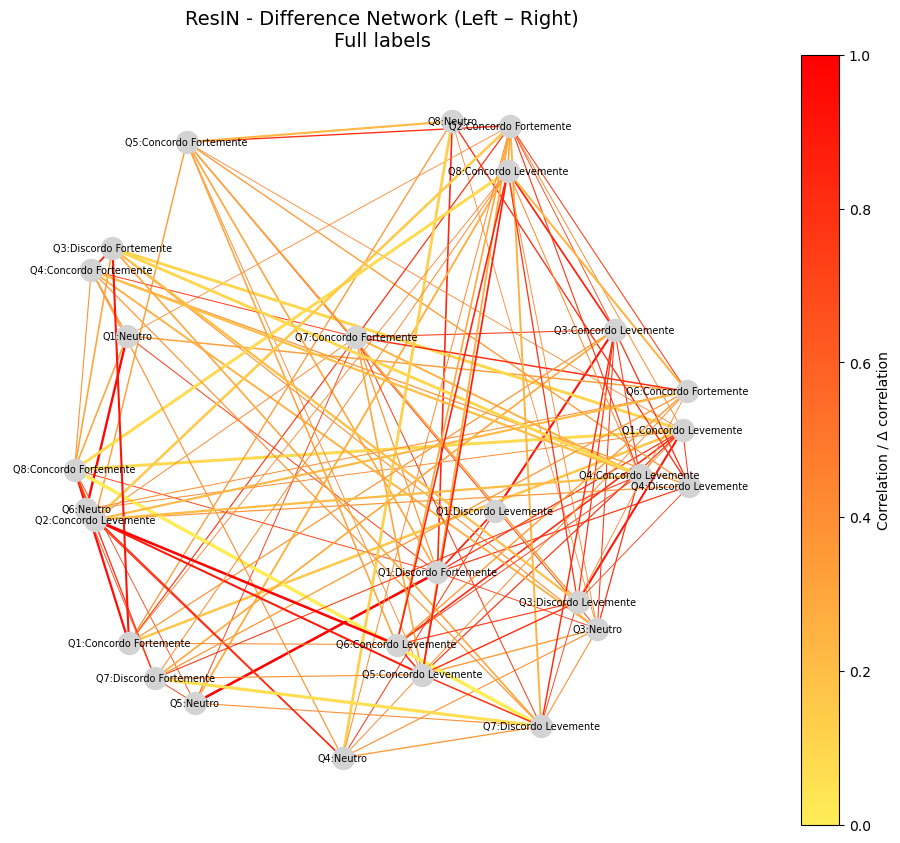

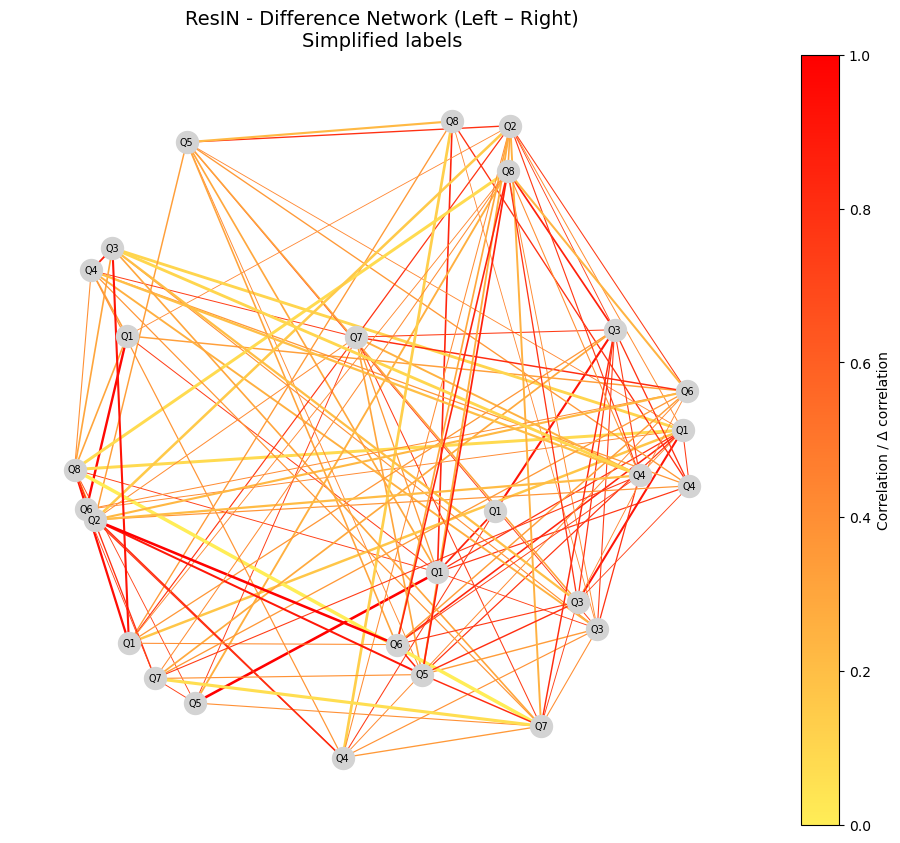


=== Homogeneity metrics ===
Left   -> density=0.254, avg strength=0.292, modularity=1.244
Right  -> density=0.642, avg strength=0.211, modularity=1.061


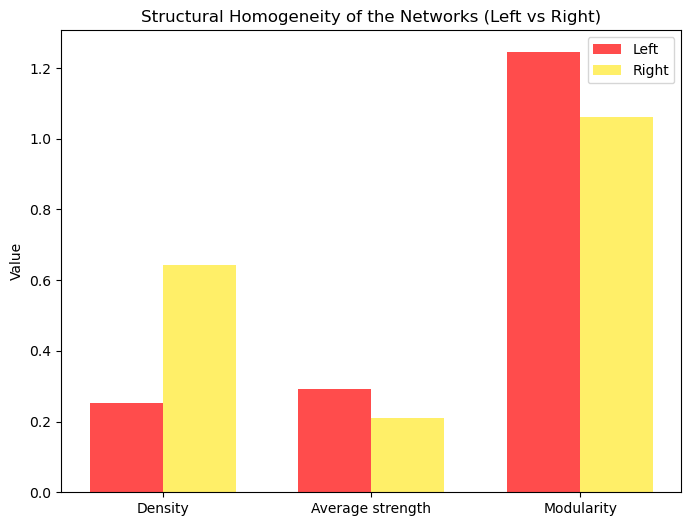


Reference map (question -> code Qn):

Q1 -> O aborto deve ser legal
Q2 -> O governo deve tomar medidas para reduzir a desigualdade de renda.
Q3 -> Todos os imigrantes em situação irregular devem ser enviados de volta ao seu país de origem.
Q4 -> O orçamento federal destinado a programas sociais (como Bolsa Família e afins) deve ser aumentado.
Q5 -> Casais lésbicos, gays e trans devem ter o direito de se casar legalmente.
Q6 -> O governo deve regulamentar as empresas para proteger o meio ambiente.
Q7 -> O governo federal deve tornar mais fácil a compra de armas de fogo.
Q8 -> O governo deve fazer um esforço concentrado para melhorar as condições sociais e econômicas da população negra no Brasil.


In [13]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from matplotlib.colors import LinearSegmentedColormap

# ==============================
# 1. Load dataset
# ==============================
df = pd.read_csv("Política Brasil.csv")

# Political identification column (kept in Portuguese from CSV)
group_col = "Primeiramente, me identifico politicamente como:"

# Survey items (ignoring timestamp and final comments)
items = df.columns[2:-1]

# Create reference map question -> Q1, Q2...
question_map = {item: f"Q{i+1}" for i, item in enumerate(items)}

# Ordered response levels (kept in Portuguese from CSV)
response_levels = [
    "Discordo Fortemente",
    "Discordo Levemente",
    "Neutro",
    "Concordo Levemente",
    "Concordo Fortemente"
]

# ==============================
# 2. Helper functions
# ==============================

def build_resin_responses(df, items, response_levels, group_mask=None, threshold=0.1):
    """
    Build a ResIN network where each node = (item, response level).
    """
    if group_mask is not None:
        df = df[group_mask].copy()
    df = df.dropna(subset=items)
    
    node_list = []
    bin_mat = []
    for item in items:
        for lvl in response_levels:
            node = (item, lvl)
            node_list.append(node)
            bin_mat.append((df[item] == lvl).astype(int).values)
    bin_mat = np.vstack(bin_mat).T
    
    corr = np.corrcoef(bin_mat, rowvar=False)
    
    G = nx.Graph()
    for node in node_list:
        G.add_node(node)
    n = len(node_list)
    for i in range(n):
        for j in range(i+1, n):
            w = corr[i, j]
            if not np.isnan(w) and abs(w) >= threshold:
                G.add_edge(node_list[i], node_list[j], weight=w)
    return G, corr, node_list


def layout_and_rotate(G, node_list):
    """Spring layout + PCA rotation to align the main axis horizontally."""
    pos = nx.spring_layout(G, weight="weight", seed=42)
    coords = np.array([pos[n] for n in node_list])
    pca = PCA(n_components=2)
    coords2 = pca.fit_transform(coords)
    pos2 = {node_list[i]: tuple(coords2[i]) for i in range(len(node_list))}
    return pos2


def plot_resin(G, pos, cmap, title="ResIN", simplified=True):
    """
    Plot ResIN network with option for simplified labels (Q1, Q2...).
    """
    plt.figure(figsize=(12, 10))
    edges = G.edges(data=True)
    weights = [d['weight'] for _, _, d in edges]

    nx.draw_networkx_nodes(G, pos, node_size=250, node_color="lightgray")
    nx.draw_networkx_edges(
        G, pos,
        edgelist=edges,
        width=[3*abs(w) for w in weights],
        edge_color=weights, edge_cmap=cmap
    )

    if simplified:
        labels = {n: f"{question_map[n[0]]}" for n in G.nodes()}
    else:
        labels = {n: f"{question_map[n[0]]}:{n[1]}" for n in G.nodes()}
    nx.draw_networkx_labels(G, pos, labels=labels, font_size=7)

    plt.title(title, fontsize=14)
    plt.colorbar(
        plt.cm.ScalarMappable(cmap=cmap),
        label="Correlation / Δ correlation"
    )
    plt.axis("off")
    plt.show()


# ==============================
# 3. Build Left vs Right networks
# ==============================
mask_left = df[group_col].str.contains("Esquerda", case=False, na=False)
mask_right = df[group_col].str.contains("Direita", case=False, na=False)

G_left, corr_left, nodes = build_resin_responses(df, items, response_levels, mask_left)
G_right, corr_right, _ = build_resin_responses(df, items, response_levels, mask_right)

pos_left = layout_and_rotate(G_left, nodes)
pos_right = layout_and_rotate(G_right, nodes)

# Standard palette for individual networks
cmap_standard = plt.cm.coolwarm

plot_resin(G_left, pos_left, cmap_standard, "ResIN - Left", simplified=True)
plot_resin(G_right, pos_right, cmap_standard, "ResIN - Right", simplified=True)

# ==============================
# 4. Difference network (Δ Left – Right)
# ==============================
diff_matrix = corr_left - corr_right
G_diff = nx.Graph()
n = len(nodes)
for i in range(n):
    for j in range(i+1, n):
        delta = diff_matrix[i, j]
        if not np.isnan(delta) and abs(delta) >= 0.2:
            G_diff.add_edge(nodes[i], nodes[j], weight=delta)

pos_diff = layout_and_rotate(G_diff, list(G_diff.nodes()))

# Custom colormap: red (Left stronger), light yellow (Right stronger, CBF style)
cdict = {
    "red":   ((0.0, 1.0, 1.0), (1.0, 1.0, 1.0)),
    "green": ((0.0, 0.93, 0.93), (1.0, 0.0, 0.0)),
    "blue":  ((0.0, 0.34, 0.34), (1.0, 0.0, 0.0)),
}
cmap_diff = LinearSegmentedColormap("RedLightYellow", cdict)

# === Plot with full labels ===
plot_resin(G_diff, pos_diff, cmap_diff,
           "ResIN - Difference Network (Left – Right)\nFull labels",
           simplified=False)

# === Plot with simplified labels (Q1, Q2...) ===
plot_resin(G_diff, pos_diff, cmap_diff,
           "ResIN - Difference Network (Left – Right)\nSimplified labels",
           simplified=True)

# ==============================
# 5. Homogeneity metrics: Left vs Right
# ==============================
def network_homogeneity(G):
    """Compute homogeneity metrics for a ResIN network."""
    n = len(G.nodes())
    m = len(G.edges())
    density = nx.density(G)
    avg_strength = np.mean([abs(d['weight']) for _, _, d in G.edges(data=True)]) if m > 0 else 0
    if m > 0:
        communities = nx.algorithms.community.greedy_modularity_communities(G, weight="weight")
        modularity = nx.algorithms.community.modularity(G, communities, weight="weight")
    else:
        modularity = 0
    return density, avg_strength, modularity

density_left, strength_left, modularity_left = network_homogeneity(G_left)
density_right, strength_right, modularity_right = network_homogeneity(G_right)

print("\n=== Homogeneity metrics ===")
print(f"Left   -> density={density_left:.3f}, avg strength={strength_left:.3f}, modularity={modularity_left:.3f}")
print(f"Right  -> density={density_right:.3f}, avg strength={strength_right:.3f}, modularity={modularity_right:.3f}")

# === 4th plot: homogeneity comparison ===
labels = ["Density", "Average strength", "Modularity"]
left_vals = [density_left, strength_left, modularity_left]
right_vals = [density_right, strength_right, modularity_right]

x = np.arange(len(labels))
width = 0.35

plt.figure(figsize=(8,6))
plt.bar(x - width/2, left_vals, width, label="Left", color="red", alpha=0.7)
plt.bar(x + width/2, right_vals, width, label="Right", color="#FFEE58", alpha=0.9)  # light yellow
plt.xticks(x, labels)
plt.ylabel("Value")
plt.title("Structural Homogeneity of the Networks (Left vs Right)")
plt.legend()
plt.show()

# ==============================
# 6. Print reference map
# ==============================
print("\nReference map (question -> code Qn):\n")
for i, item in enumerate(items, start=1):
    print(f"Q{i} -> {item}")


/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/tmp/ipykernel_23996/4252866099.py:85: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(
/tmp/ipykernel_23996/4252866099.py:99: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* a

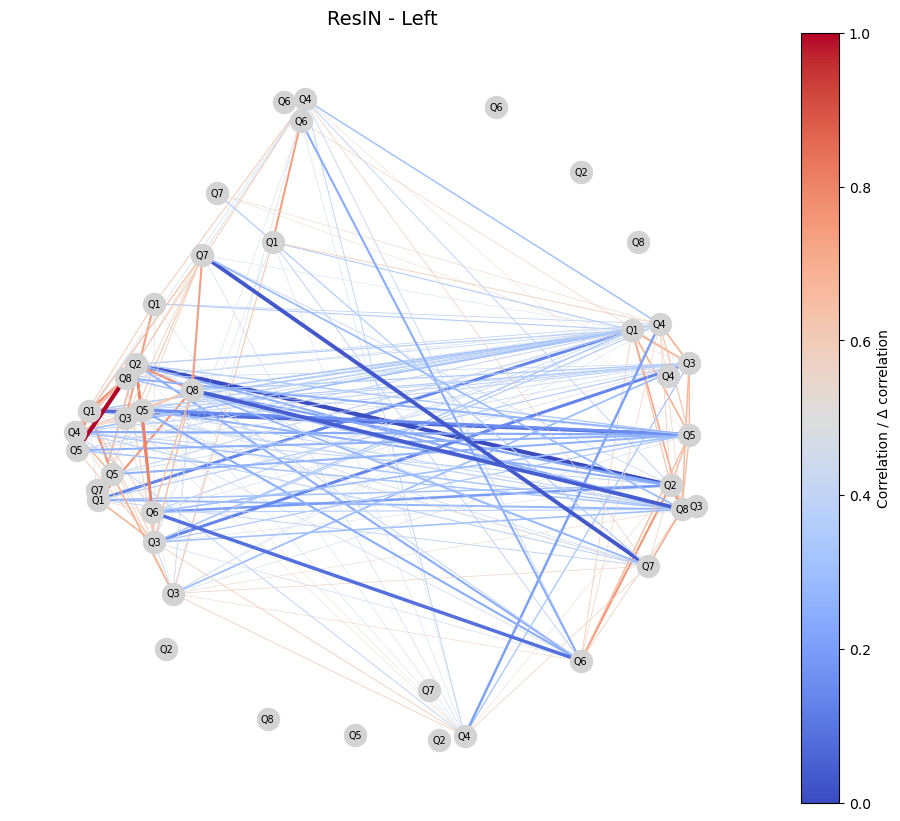

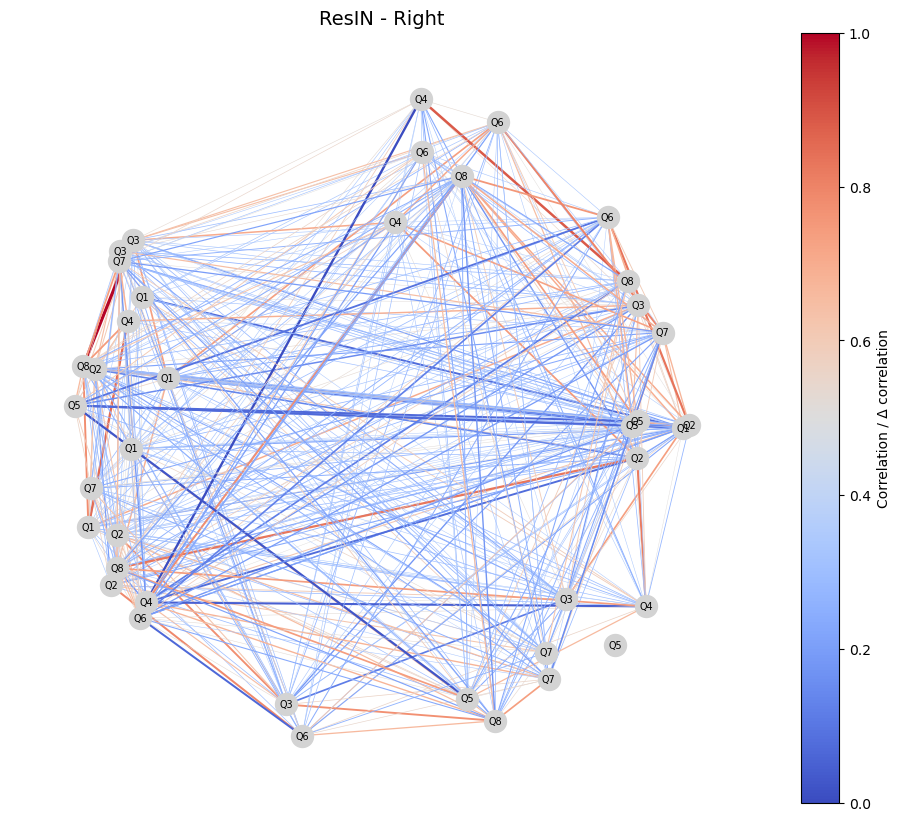

/tmp/ipykernel_23996/4252866099.py:85: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(
/tmp/ipykernel_23996/4252866099.py:99: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(


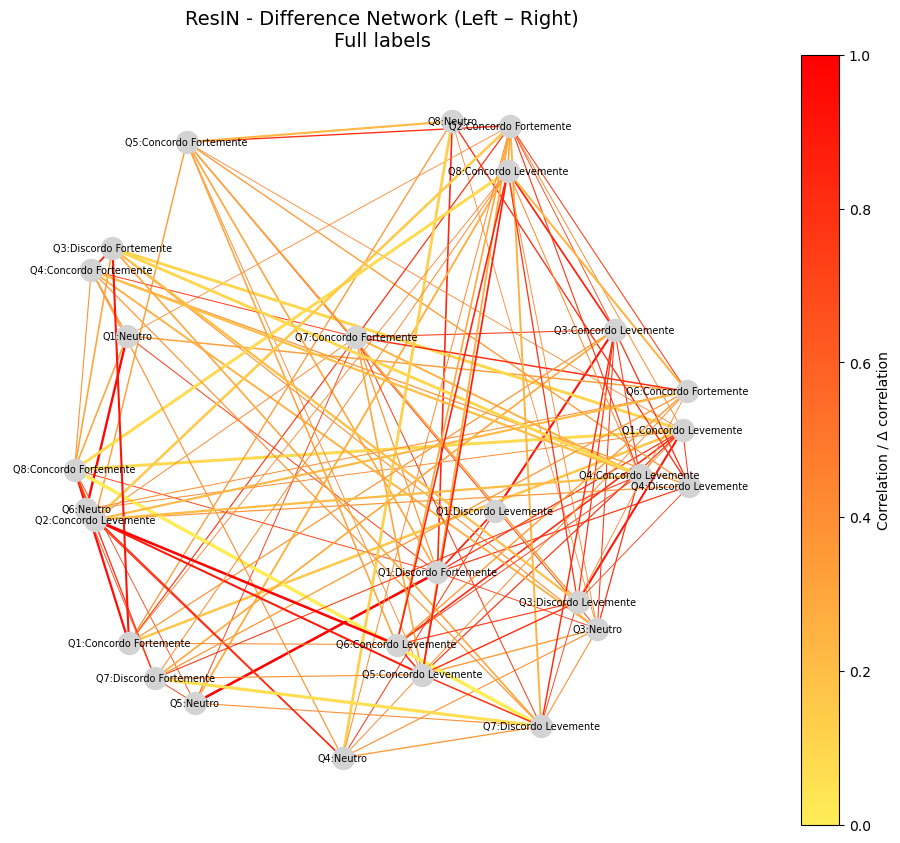

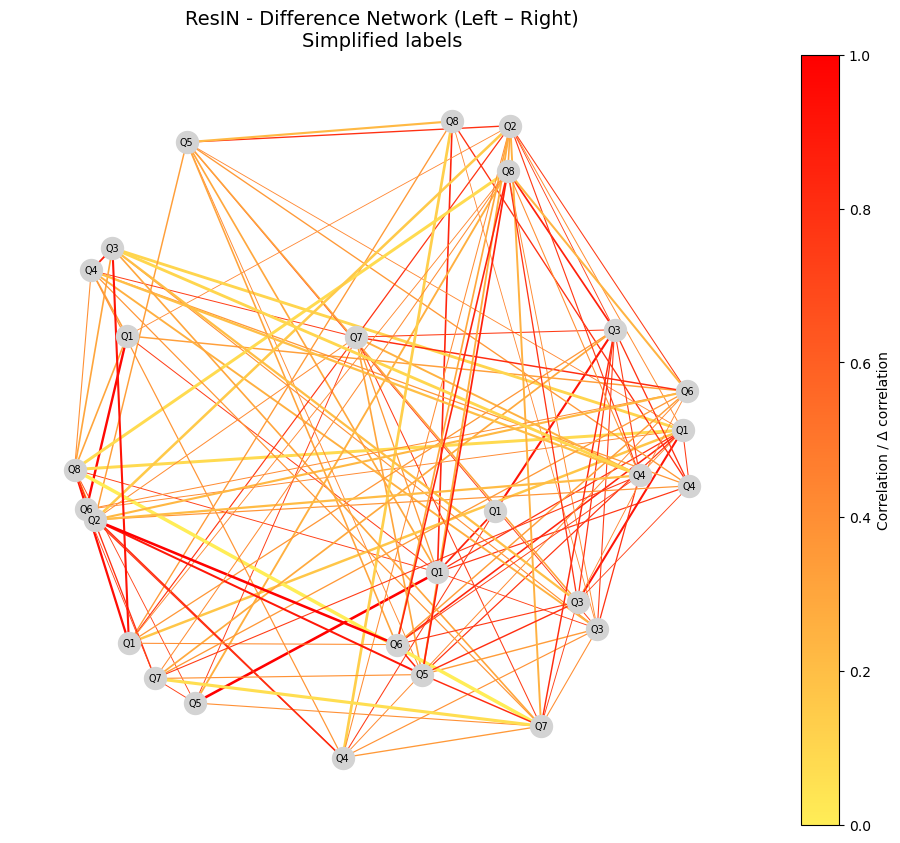


=== Homogeneity metrics ===
Left   -> density=0.254, avg strength=0.292, modularity=1.244
Right  -> density=0.642, avg strength=0.211, modularity=1.061


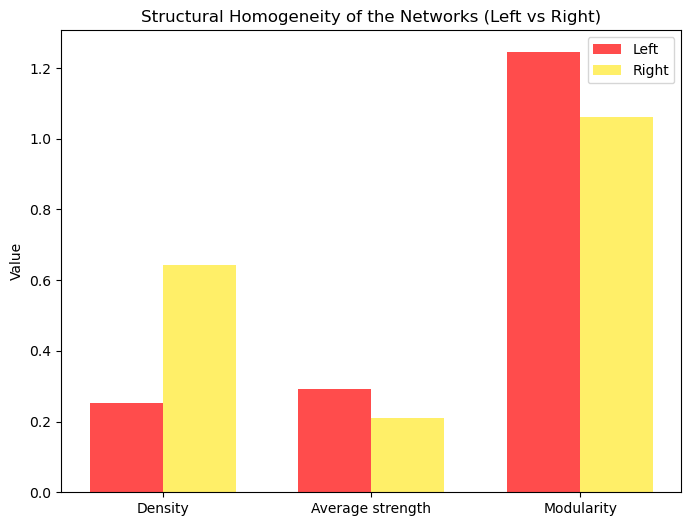


Reference map (question -> Qn):

Q1 -> [PT] O aborto deve ser legal
       [EN] Abortion should be legal

Q2 -> [PT] O governo deve tomar medidas para reduzir a desigualdade de renda.
       [EN] The government should take measures to reduce income inequality.

Q3 -> [PT] Todos os imigrantes em situação irregular devem ser enviados de volta ao seu país de origem.
       [EN] All undocumented immigrants should be sent back to their home country.

Q4 -> [PT] O orçamento federal destinado a programas sociais (como Bolsa Família e afins) deve ser aumentado.
       [EN] The federal budget for social programs (such as Bolsa Família) should be increased.

Q5 -> [PT] Casais lésbicos, gays e trans devem ter o direito de se casar legalmente.
       [EN] Lesbian, gay and trans couples should have the right to legally marry.

Q6 -> [PT] O governo deve regulamentar as empresas para proteger o meio ambiente.
       [EN] The government should regulate companies to protect the environment.

Q7 -> [PT

In [14]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from matplotlib.colors import LinearSegmentedColormap

# ==============================
# 1. Load dataset
# ==============================
df = pd.read_csv("Política Brasil.csv")

# Political identification column (kept in Portuguese from CSV)
group_col = "Primeiramente, me identifico politicamente como:"

# Survey items (ignoring timestamp and final comments)
items = df.columns[2:-1]

# Create reference map question -> Q1, Q2...
question_map = {item: f"Q{i+1}" for i, item in enumerate(items)}

# Ordered response levels (kept in Portuguese from CSV)
response_levels = [
    "Discordo Fortemente",
    "Discordo Levemente",
    "Neutro",
    "Concordo Levemente",
    "Concordo Fortemente"
]

# ==============================
# 2. Helper functions
# ==============================

def build_resin_responses(df, items, response_levels, group_mask=None, threshold=0.1):
    """
    Build a ResIN network where each node = (item, response level).
    """
    if group_mask is not None:
        df = df[group_mask].copy()
    df = df.dropna(subset=items)
    
    node_list = []
    bin_mat = []
    for item in items:
        for lvl in response_levels:
            node = (item, lvl)
            node_list.append(node)
            bin_mat.append((df[item] == lvl).astype(int).values)
    bin_mat = np.vstack(bin_mat).T
    
    corr = np.corrcoef(bin_mat, rowvar=False)
    
    G = nx.Graph()
    for node in node_list:
        G.add_node(node)
    n = len(node_list)
    for i in range(n):
        for j in range(i+1, n):
            w = corr[i, j]
            if not np.isnan(w) and abs(w) >= threshold:
                G.add_edge(node_list[i], node_list[j], weight=w)
    return G, corr, node_list


def layout_and_rotate(G, node_list):
    """Spring layout + PCA rotation to align the main axis horizontally."""
    pos = nx.spring_layout(G, weight="weight", seed=42)
    coords = np.array([pos[n] for n in node_list])
    pca = PCA(n_components=2)
    coords2 = pca.fit_transform(coords)
    pos2 = {node_list[i]: tuple(coords2[i]) for i in range(len(node_list))}
    return pos2


def plot_resin(G, pos, cmap, title="ResIN", simplified=True):
    """
    Plot ResIN network with option for simplified labels (Q1, Q2...).
    """
    plt.figure(figsize=(12, 10))
    edges = G.edges(data=True)
    weights = [d['weight'] for _, _, d in edges]

    nx.draw_networkx_nodes(G, pos, node_size=250, node_color="lightgray")
    nx.draw_networkx_edges(
        G, pos,
        edgelist=edges,
        width=[3*abs(w) for w in weights],
        edge_color=weights, edge_cmap=cmap
    )

    if simplified:
        labels = {n: f"{question_map[n[0]]}" for n in G.nodes()}
    else:
        labels = {n: f"{question_map[n[0]]}:{n[1]}" for n in G.nodes()}
    nx.draw_networkx_labels(G, pos, labels=labels, font_size=7)

    plt.title(title, fontsize=14)
    plt.colorbar(
        plt.cm.ScalarMappable(cmap=cmap),
        label="Correlation / Δ correlation"
    )
    plt.axis("off")
    plt.show()


# ==============================
# 3. Build Left vs Right networks
# ==============================
mask_left = df[group_col].str.contains("Esquerda", case=False, na=False)
mask_right = df[group_col].str.contains("Direita", case=False, na=False)

G_left, corr_left, nodes = build_resin_responses(df, items, response_levels, mask_left)
G_right, corr_right, _ = build_resin_responses(df, items, response_levels, mask_right)

pos_left = layout_and_rotate(G_left, nodes)
pos_right = layout_and_rotate(G_right, nodes)

# Standard palette for individual networks
cmap_standard = plt.cm.coolwarm

plot_resin(G_left, pos_left, cmap_standard, "ResIN - Left", simplified=True)
plot_resin(G_right, pos_right, cmap_standard, "ResIN - Right", simplified=True)

# ==============================
# 4. Difference network (Δ Left – Right)
# ==============================
diff_matrix = corr_left - corr_right
G_diff = nx.Graph()
n = len(nodes)
for i in range(n):
    for j in range(i+1, n):
        delta = diff_matrix[i, j]
        if not np.isnan(delta) and abs(delta) >= 0.2:
            G_diff.add_edge(nodes[i], nodes[j], weight=delta)

pos_diff = layout_and_rotate(G_diff, list(G_diff.nodes()))

# Custom colormap: red (Left stronger), light yellow (Right stronger, CBF style)
cdict = {
    "red":   ((0.0, 1.0, 1.0), (1.0, 1.0, 1.0)),
    "green": ((0.0, 0.93, 0.93), (1.0, 0.0, 0.0)),
    "blue":  ((0.0, 0.34, 0.34), (1.0, 0.0, 0.0)),
}
cmap_diff = LinearSegmentedColormap("RedLightYellow", cdict)

# === Plot with full labels ===
plot_resin(G_diff, pos_diff, cmap_diff,
           "ResIN - Difference Network (Left – Right)\nFull labels",
           simplified=False)

# === Plot with simplified labels (Q1, Q2...) ===
plot_resin(G_diff, pos_diff, cmap_diff,
           "ResIN - Difference Network (Left – Right)\nSimplified labels",
           simplified=True)

# ==============================
# 5. Homogeneity metrics: Left vs Right
# ==============================
def network_homogeneity(G):
    """Compute homogeneity metrics for a ResIN network."""
    n = len(G.nodes())
    m = len(G.edges())
    density = nx.density(G)
    avg_strength = np.mean([abs(d['weight']) for _, _, d in G.edges(data=True)]) if m > 0 else 0
    if m > 0:
        communities = nx.algorithms.community.greedy_modularity_communities(G, weight="weight")
        modularity = nx.algorithms.community.modularity(G, communities, weight="weight")
    else:
        modularity = 0
    return density, avg_strength, modularity

density_left, strength_left, modularity_left = network_homogeneity(G_left)
density_right, strength_right, modularity_right = network_homogeneity(G_right)

print("\n=== Homogeneity metrics ===")
print(f"Left   -> density={density_left:.3f}, avg strength={strength_left:.3f}, modularity={modularity_left:.3f}")
print(f"Right  -> density={density_right:.3f}, avg strength={strength_right:.3f}, modularity={modularity_right:.3f}")

# === 4th plot: homogeneity comparison ===
labels = ["Density", "Average strength", "Modularity"]
left_vals = [density_left, strength_left, modularity_left]
right_vals = [density_right, strength_right, modularity_right]

x = np.arange(len(labels))
width = 0.35

plt.figure(figsize=(8,6))
plt.bar(x - width/2, left_vals, width, label="Left", color="red", alpha=0.7)
plt.bar(x + width/2, right_vals, width, label="Right", color="#FFEE58", alpha=0.9)  # light yellow
plt.xticks(x, labels)
plt.ylabel("Value")
plt.title("Structural Homogeneity of the Networks (Left vs Right)")
plt.legend()
plt.show()

# ==============================
# 6. Print reference map (Portuguese + English)
# ==============================

# Manual dictionary of translations (Portuguese -> English)
translations = {
    "O aborto deve ser legal": "Abortion should be legal",
    "O governo deve tomar medidas para reduzir a desigualdade de renda.": "The government should take measures to reduce income inequality.",
    "Todos os imigrantes em situação irregular devem ser enviados de volta ao seu país de origem.": "All undocumented immigrants should be sent back to their home country.",
    "O orçamento federal destinado a programas sociais (como Bolsa Família e afins) deve ser aumentado.": "The federal budget for social programs (such as Bolsa Família) should be increased.",
    "Casais lésbicos, gays e trans devem ter o direito de se casar legalmente.": "Lesbian, gay and trans couples should have the right to legally marry.",
    "O governo deve regulamentar as empresas para proteger o meio ambiente.": "The government should regulate companies to protect the environment.",
    "O governo federal deve tornar mais fácil a compra de armas de fogo.": "The federal government should make it easier to buy firearms.",
    "O governo deve fazer um esforço concentrado para melhorar as condições sociais e econômicas da população negra no Brasil.": "The government should make a concentrated effort to improve the social and economic conditions of the Black population in Brazil."
}

print("\nReference map (question -> Qn):\n")
for i, item in enumerate(items, start=1):
    pt = item.strip()
    en = translations.get(pt, "[translation missing]")
    print(f"Q{i} -> [PT] {pt}\n       [EN] {en}\n")



/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/usr/lib/python3/dist-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/tmp/ipykernel_27108/776036123.py:86: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(
/tmp/ipykernel_27108/776036123.py:100: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* ar

Plot saved as resin_left.png


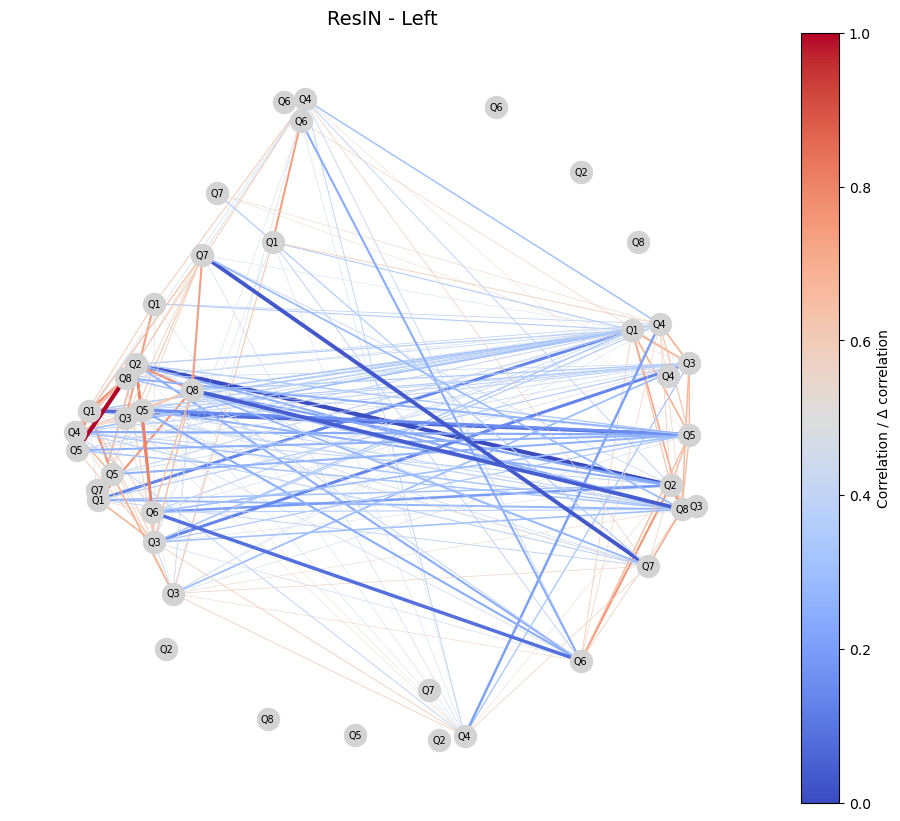

Plot saved as resin_right.png


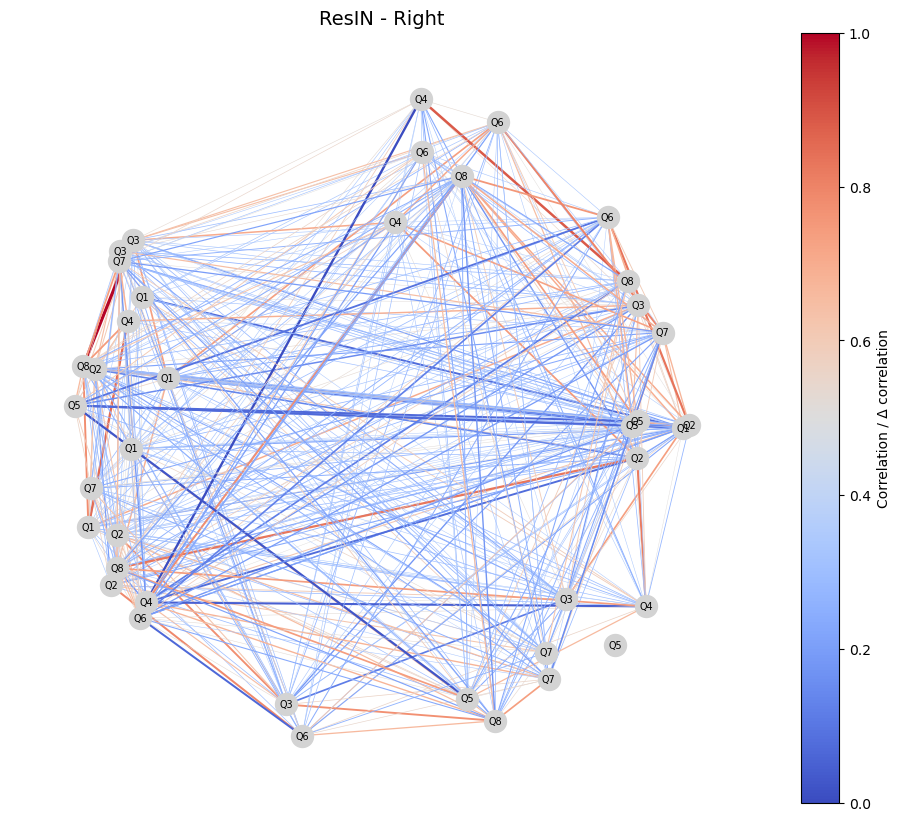

/tmp/ipykernel_27108/776036123.py:86: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(
/tmp/ipykernel_27108/776036123.py:100: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(


Plot saved as resin_diff_full.png


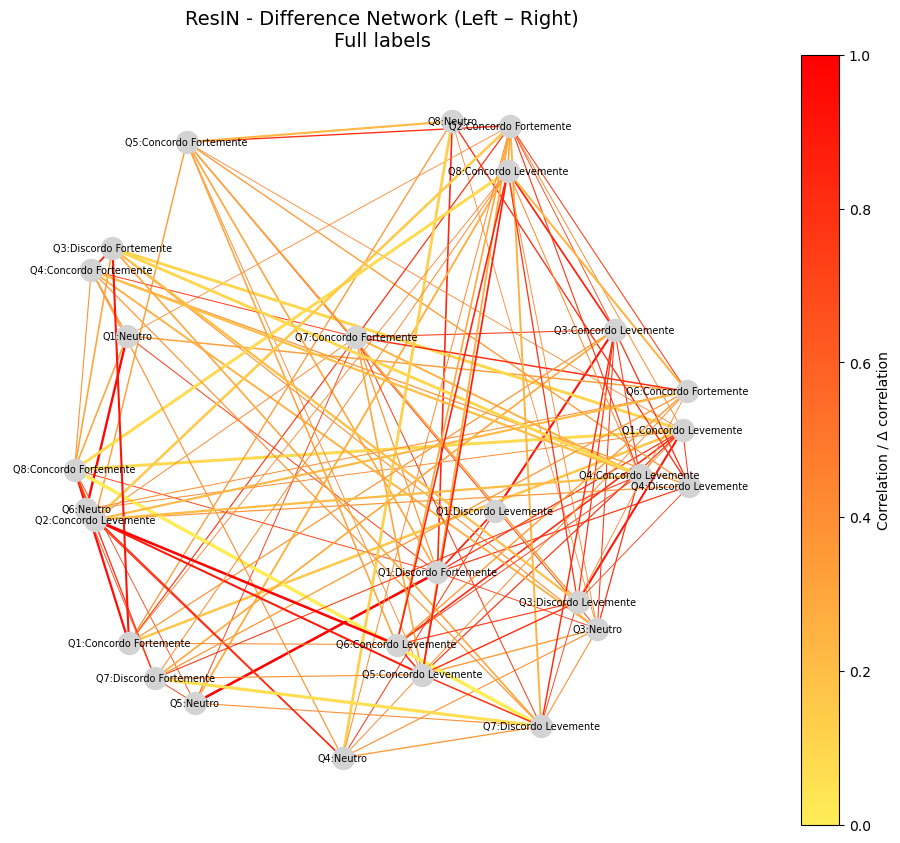

Plot saved as resin_diff_simple.png


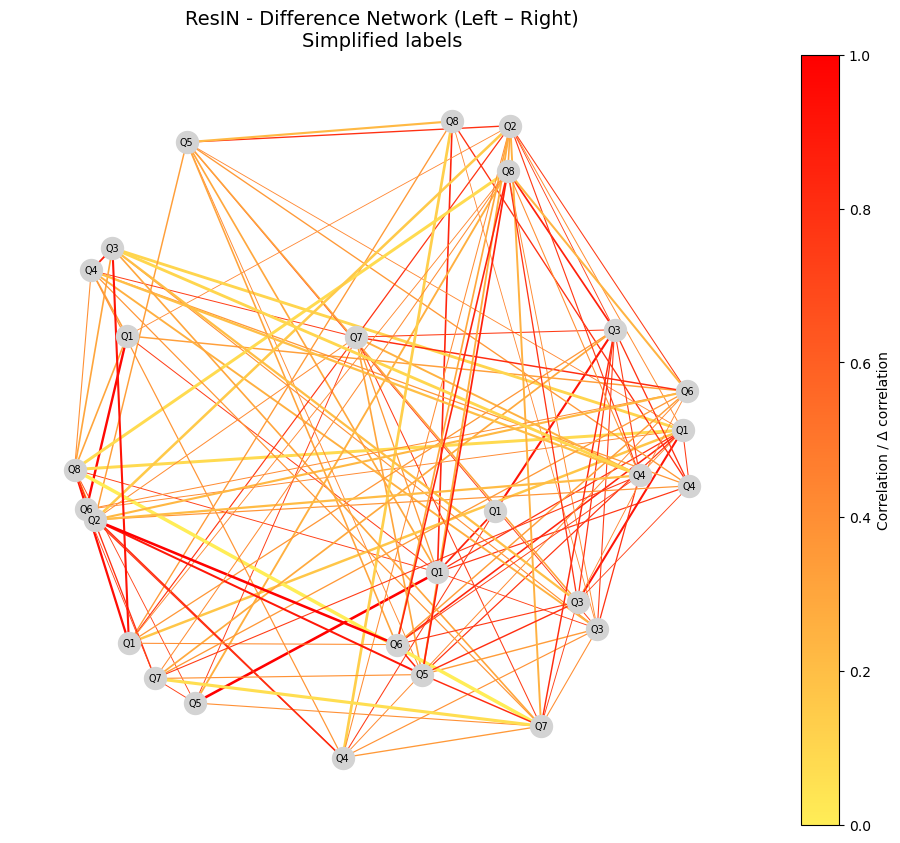


=== Homogeneity metrics ===
Left   -> density=0.254, avg strength=0.292, modularity=1.244
Right  -> density=0.642, avg strength=0.211, modularity=1.061
Plot saved as resin_homogeneity.png


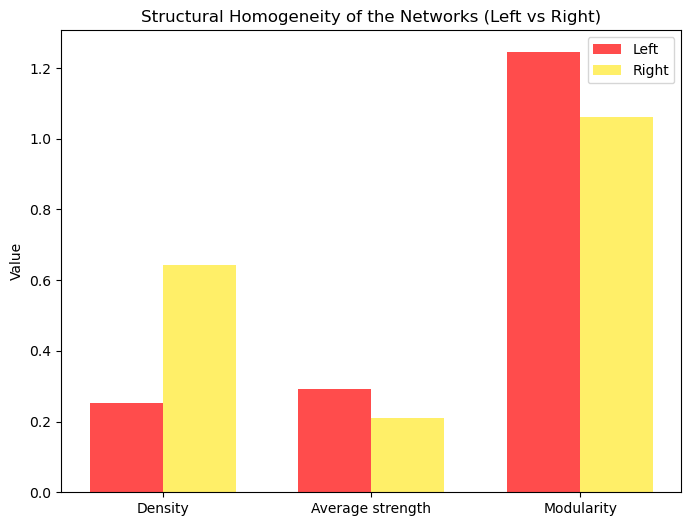


Reference map (question -> code Qn):

Q1 -> [PT] O aborto deve ser legal
       [EN] Abortion should be legal

Q2 -> [PT] O governo deve tomar medidas para reduzir a desigualdade de renda.
       [EN] The government should take measures to reduce income inequality.

Q3 -> [PT] Todos os imigrantes em situação irregular devem ser enviados de volta ao seu país de origem.
       [EN] All undocumented immigrants should be sent back to their home country.

Q4 -> [PT] O orçamento federal destinado a programas sociais (como Bolsa Família e afins) deve ser aumentado.
       [EN] The federal budget for social programs (such as Bolsa Família) should be increased.

Q5 -> [PT] Casais lésbicos, gays e trans devem ter o direito de se casar legalmente.
       [EN] Lesbian, gay and trans couples should have the right to legally marry.

Q6 -> [PT] O governo deve regulamentar as empresas para proteger o meio ambiente.
       [EN] The government should regulate companies to protect the environment.

Q7 -

In [1]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from matplotlib.colors import LinearSegmentedColormap

# ==============================
# 1. Load dataset
# ==============================
df = pd.read_csv("Política Brasil.csv")

# Political identification column (kept in Portuguese from CSV)
group_col = "Primeiramente, me identifico politicamente como:"

# Survey items (ignoring timestamp and final comments)
items = df.columns[2:-1]

# Create reference map question -> Q1, Q2...
question_map = {item: f"Q{i+1}" for i, item in enumerate(items)}

# Ordered response levels (kept in Portuguese from CSV)
response_levels = [
    "Discordo Fortemente",
    "Discordo Levemente",
    "Neutro",
    "Concordo Levemente",
    "Concordo Fortemente"
]

# ==============================
# 2. Helper functions
# ==============================

def build_resin_responses(df, items, response_levels, group_mask=None, threshold=0.1):
    """
    Build a ResIN network where each node = (item, response level).
    """
    if group_mask is not None:
        df = df[group_mask].copy()
    df = df.dropna(subset=items)
    
    node_list = []
    bin_mat = []
    for item in items:
        for lvl in response_levels:
            node = (item, lvl)
            node_list.append(node)
            bin_mat.append((df[item] == lvl).astype(int).values)
    bin_mat = np.vstack(bin_mat).T
    
    corr = np.corrcoef(bin_mat, rowvar=False)
    
    G = nx.Graph()
    for node in node_list:
        G.add_node(node)
    n = len(node_list)
    for i in range(n):
        for j in range(i+1, n):
            w = corr[i, j]
            if not np.isnan(w) and abs(w) >= threshold:
                G.add_edge(node_list[i], node_list[j], weight=w)
    return G, corr, node_list


def layout_and_rotate(G, node_list):
    """Spring layout + PCA rotation to align the main axis horizontally."""
    pos = nx.spring_layout(G, weight="weight", seed=42)
    coords = np.array([pos[n] for n in node_list])
    pca = PCA(n_components=2)
    coords2 = pca.fit_transform(coords)
    pos2 = {node_list[i]: tuple(coords2[i]) for i in range(len(node_list))}
    return pos2


def plot_resin(G, pos, cmap, title="ResIN", simplified=True, filename=None):
    """
    Plot ResIN network with option for simplified labels (Q1, Q2...).
    If filename is given, save the plot as a PNG image.
    """
    plt.figure(figsize=(12, 10))
    edges = G.edges(data=True)
    weights = [d['weight'] for _, _, d in edges]

    nx.draw_networkx_nodes(G, pos, node_size=250, node_color="lightgray")
    nx.draw_networkx_edges(
        G, pos,
        edgelist=edges,
        width=[3*abs(w) for w in weights],
        edge_color=weights, edge_cmap=cmap
    )

    if simplified:
        labels = {n: f"{question_map[n[0]]}" for n in G.nodes()}
    else:
        labels = {n: f"{question_map[n[0]]}:{n[1]}" for n in G.nodes()}
    nx.draw_networkx_labels(G, pos, labels=labels, font_size=7)

    plt.title(title, fontsize=14)
    plt.colorbar(
        plt.cm.ScalarMappable(cmap=cmap),
        label="Correlation / Δ correlation"
    )
    plt.axis("off")

    if filename:
        plt.savefig(filename, dpi=300, bbox_inches="tight")
        print(f"Plot saved as {filename}")
    plt.show()

# ==============================
# 3. Build Left vs Right networks
# ==============================
mask_left = df[group_col].str.contains("Esquerda", case=False, na=False)
mask_right = df[group_col].str.contains("Direita", case=False, na=False)

G_left, corr_left, nodes = build_resin_responses(df, items, response_levels, mask_left)
G_right, corr_right, _ = build_resin_responses(df, items, response_levels, mask_right)

pos_left = layout_and_rotate(G_left, nodes)
pos_right = layout_and_rotate(G_right, nodes)

# Standard palette for individual networks
cmap_standard = plt.cm.coolwarm

plot_resin(G_left, pos_left, cmap_standard, "ResIN - Left", simplified=True, filename="resin_left.png")
plot_resin(G_right, pos_right, cmap_standard, "ResIN - Right", simplified=True, filename="resin_right.png")

# ==============================
# 4. Difference network (Δ Left – Right)
# ==============================
diff_matrix = corr_left - corr_right
G_diff = nx.Graph()
n = len(nodes)
for i in range(n):
    for j in range(i+1, n):
        delta = diff_matrix[i, j]
        if not np.isnan(delta) and abs(delta) >= 0.2:
            G_diff.add_edge(nodes[i], nodes[j], weight=delta)

pos_diff = layout_and_rotate(G_diff, list(G_diff.nodes()))

# Custom colormap: red (Left stronger), light yellow (Right stronger, CBF style)
cdict = {
    "red":   ((0.0, 1.0, 1.0), (1.0, 1.0, 1.0)),
    "green": ((0.0, 0.93, 0.93), (1.0, 0.0, 0.0)),
    "blue":  ((0.0, 0.34, 0.34), (1.0, 0.0, 0.0)),
}
cmap_diff = LinearSegmentedColormap("RedLightYellow", cdict)

plot_resin(G_diff, pos_diff, cmap_diff,
           "ResIN - Difference Network (Left – Right)\nFull labels",
           simplified=False, filename="resin_diff_full.png")

plot_resin(G_diff, pos_diff, cmap_diff,
           "ResIN - Difference Network (Left – Right)\nSimplified labels",
           simplified=True, filename="resin_diff_simple.png")

# ==============================
# 5. Homogeneity metrics: Left vs Right
# ==============================
def network_homogeneity(G):
    """Compute homogeneity metrics for a ResIN network."""
    n = len(G.nodes())
    m = len(G.edges())
    density = nx.density(G)
    avg_strength = np.mean([abs(d['weight']) for _, _, d in G.edges(data=True)]) if m > 0 else 0
    if m > 0:
        communities = nx.algorithms.community.greedy_modularity_communities(G, weight="weight")
        modularity = nx.algorithms.community.modularity(G, communities, weight="weight")
    else:
        modularity = 0
    return density, avg_strength, modularity

density_left, strength_left, modularity_left = network_homogeneity(G_left)
density_right, strength_right, modularity_right = network_homogeneity(G_right)

print("\n=== Homogeneity metrics ===")
print(f"Left   -> density={density_left:.3f}, avg strength={strength_left:.3f}, modularity={modularity_left:.3f}")
print(f"Right  -> density={density_right:.3f}, avg strength={strength_right:.3f}, modularity={modularity_right:.3f}")

labels = ["Density", "Average strength", "Modularity"]
left_vals = [density_left, strength_left, modularity_left]
right_vals = [density_right, strength_right, modularity_right]

x = np.arange(len(labels))
width = 0.35

plt.figure(figsize=(8,6))
plt.bar(x - width/2, left_vals, width, label="Left", color="red", alpha=0.7)
plt.bar(x + width/2, right_vals, width, label="Right", color="#FFEE58", alpha=0.9)
plt.xticks(x, labels)
plt.ylabel("Value")
plt.title("Structural Homogeneity of the Networks (Left vs Right)")
plt.legend()
plt.savefig("resin_homogeneity.png", dpi=300, bbox_inches="tight")
print("Plot saved as resin_homogeneity.png")
plt.show()

# ==============================
# 6. Print reference map (Portuguese + English)
# ==============================

translations = {
    "O aborto deve ser legal": "Abortion should be legal",
    "O governo deve tomar medidas para reduzir a desigualdade de renda.": "The government should take measures to reduce income inequality.",
    "Todos os imigrantes em situação irregular devem ser enviados de volta ao seu país de origem.": "All undocumented immigrants should be sent back to their home country.",
    "O orçamento federal destinado a programas sociais (como Bolsa Família e afins) deve ser aumentado.": "The federal budget for social programs (such as Bolsa Família) should be increased.",
    "Casais lésbicos, gays e trans devem ter o direito de se casar legalmente.": "Lesbian, gay and trans couples should have the right to legally marry.",
    "O governo deve regulamentar as empresas para proteger o meio ambiente.": "The government should regulate companies to protect the environment.",
    "O governo federal deve tornar mais fácil a compra de armas de fogo.": "The federal government should make it easier to buy firearms.",
    "O governo deve fazer um esforço concentrado para melhorar as condições sociais e econômicas da população negra no Brasil.": "The government should make a concentrated effort to improve the social and economic conditions of the Black population in Brazil."
}

print("\nReference map (question -> code Qn):\n")
for i, item in enumerate(items, start=1):
    pt = item.strip()
    en = translations.get(pt, "[translation missing]")
    print(f"Q{i} -> [PT] {pt}\n       [EN] {en}\n")
